In [1]:
%load_ext autoreload
%autoreload 2

In [41]:
import numpy as np
import lightkurve as lk
import matplotlib.pyplot as plt
from scipy import stats

from tess_backml import BackgroundCube
from tess_backml.utils import animate_cube, pooling_2d

from scipy.interpolate import RectBivariateSpline, griddata
from tqdm import tqdm

from patsy import dmatrix
from scipy import sparse
from IPython.display import HTML

import matplotlib
matplotlib.rcParams["animation.embed_limit"] = 2**128

In [56]:
def fill_nan_with_interpolation(array, method='linear'):
    """Fills NaN values in a 2D NumPy array using interpolation.

    Args:
        array (np.ndarray): The 2D NumPy array.
        method (str, optional): The interpolation method. 
            Defaults to 'linear'.

    Returns:
        np.ndarray: The array with NaN values filled.
    """
    print("interp method")
    mask = np.isnan(array)
    x, y = np.arange(array.shape[1]), np.arange(array.shape[0])
    xx, yy = np.meshgrid(x, y)
    
    x_valid = xx[~mask]
    y_valid = yy[~mask]
    values_valid = array[~mask]
    
    values_interp = griddata((x_valid, y_valid), values_valid.ravel(),
                             (xx[mask], yy[mask]), method=method)
    
    filled_array = array.copy()
    filled_array[mask] = values_interp

    return filled_array

def fill_nan_linear_model(cube, deg=3):
    print("Linear modeling method")
    x, y = np.arange(cube.shape[2], dtype=float), np.arange(cube.shape[1], dtype=float)
    x = (x - np.median(x)) / np.std(x)
    y = (y - np.median(y)) / np.std(y)
    xx, yy = np.meshgrid(x, y)
    DM = np.vstack(
        [
            yy.ravel() ** idx * xx.ravel() ** jdx
            for idx in range(deg + 1)
            for jdx in range(deg + 1)
        ]
    ).T
    print(DM.shape)
    print(cube.shape)
    mask = ~np.isnan(cube[0]).ravel()
    print((~mask).sum())

    filled = []
    for idx in tqdm(range(len(cube))):
        array = cube[idx].ravel().copy()
        ws = np.linalg.solve(DM[mask].T.dot(DM[mask]), DM[mask].T.dot(array[mask]))
        array[~mask] = DM[~mask].dot(ws)
        filled.append(array.reshape(xx.shape))

    return np.array(filled)

def cut_segments(vectors, segment_masks):
        return np.hstack(
            [
                vectors[:, idx][:, None] * segment_masks
                for idx in range(vectors.shape[1])
            ]
        )

# def upscale(cube_flux, row, col, time, deg_space=3, deg_time=3):

#     row, col = np.meshgrid(x - np.mean(x), y - np.mean(y))

#     DM_pix = np.vstack(
#             [
#                 row.ravel() ** idx * col.ravel() ** jdx
#                 for idx in range(deg_space + 1)
#                 for jdx in range(deg_space + 1)
#             ]
#         ).T

#     breaks = np.where(np.diff(time) / np.median(np.diff(time)) > 5)[0] + 1
#     segment_mask = np.array_split(np.arange(len(time)), breaks)
#     segment_mask = np.asarray(
#                 [np.in1d(np.arange(len(time)), x1).astype(float) for x1 in segment_mask]
#             ).T
    
#     DM_time = np.vstack(
#             [
#                 (time - time.mean()) ** idx
#                 for idx in range(deg_time + 1)
#             ]
#         ).T
#     DM_time = cut_segments(DM_time, segment_mask)
#     return

In [4]:
rmin, rmax = 0, 2048
cmin, cmax = 45, 2093

In [5]:
sector = 2
camera = 2
ccd = 4
binsize = 8

In [6]:
cube_data = np.load(f"./data/ffi_sl_bin{binsize}_sector{sector:03}_{camera}-{ccd}.npz")
cube_data.items()

ItemsView(NpzFile './data/ffi_sl_bin8_sector002_2-4.npz' with keys: scatter_cube, time, cadenceno)

In [7]:
cube_time = cube_data["time"]
cube_cadenceno = cube_data["cadenceno"]
cube_sl = cube_data["scatter_cube"]
cube_sl.shape, cube_time.shape

((1245, 256, 256), (1245,))

In [8]:
fillnan = np.isnan(cube_sl).any()
tdx = 1172
if fillnan:
    cube_sl_lin = fill_nan_linear_model(cube_sl, deg=3)
    # cube_sl_fillcub = fill_nan_with_interpolation(cube_sl[tdx], method="cubic")

Linear modeling method
(65536, 16)
(1245, 256, 256)
102


100%|██████████| 1245/1245 [00:22<00:00, 56.13it/s]


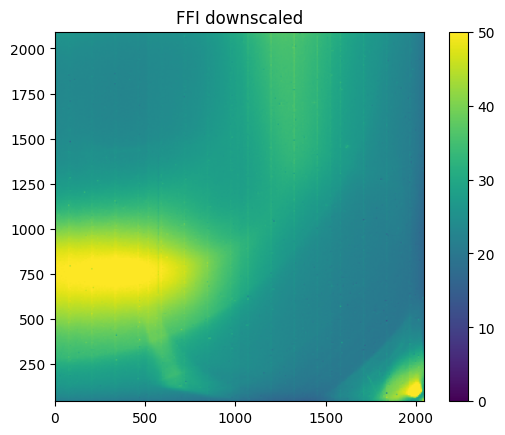

In [9]:
if fillnan:
    bar = plt.imshow(cube_sl_lin[tdx], origin="lower", vmin=0, vmax=50, extent=(rmin, rmax, cmin, cmax))
else:
    bar = plt.imshow(cube_sl[tdx], origin="lower", vmin=0, vmax=50, extent=(rmin, rmax, cmin, cmax))
plt.title("FFI downscaled")
plt.colorbar(bar)
plt.show()

In [53]:
step = binsize
row, col = np.mgrid[rmin:rmax:step, cmin:cmax:step]
row.shape

(256, 256)

In [11]:
# %%timeit
tdx = 1172
interp2d = RectBivariateSpline(col[0, :], row[:, 0], cube_sl_lin[tdx] if fillnan else cube_sl[tdx])

eval_row = np.arange(rmin, rmax)
eval_col = np.arange(cmin, cmax)

eval_sl = interp2d(eval_col, eval_row)
eval_sl

array([[21.83055878, 21.82467468, 21.81770072, ..., 46.48493195,
        46.48493195, 46.48493195],
       [21.99216474, 22.0021498 , 22.00349905, ..., 45.89949146,
        45.89949146, 45.89949146],
       [22.1381997 , 22.16099227, 22.16931252, ..., 45.27422156,
        45.27422156, 45.27422156],
       ...,
       [27.41618347, 27.40198995, 27.38046748, ..., 19.69589996,
        19.69589996, 19.69589996],
       [27.41618347, 27.40198995, 27.38046748, ..., 19.69589996,
        19.69589996, 19.69589996],
       [27.41618347, 27.40198995, 27.38046748, ..., 19.69589996,
        19.69589996, 19.69589996]])

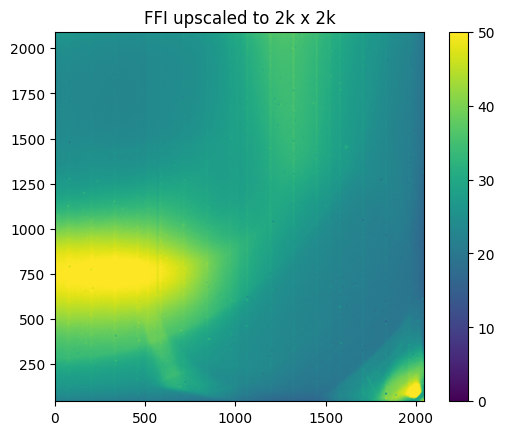

In [12]:
bar = plt.imshow(eval_sl, origin="lower", vmin=0, vmax=50, 
           extent=(eval_row.min(), eval_row.max(), eval_col.min(), eval_col.max()))
plt.title("FFI upscaled to 2k x 2k")
plt.colorbar(bar)
plt.show()

### time binning

In [88]:
time_bin = 5

# first find data gaps due to downlink
gaps = np.where(np.diff(cube_time) > 2 * np.median(np.diff(cube_time)))[0]
print(gaps)
# need to treat as separate segements for time binning

[625]


In [15]:
cube_cadenceno.shape, cube_sl_lin.shape

((1245,), (1245, 256, 256))

In [90]:
cube_sl_tb = []
cube_time_tb = []

for no, orb in enumerate(np.array_split(np.arange(cube_sl_lin.shape[0]), gaps)):
    for bins in tqdm(np.array_split(orb, np.ceil(len(orb) / time_bin)), desc=f"Orb {no}"):
        cube_sl_tb.append(np.median(cube_sl_lin[bins], axis=0))
        cube_time_tb.append(np.median(cube_time[bins]))
cube_sl_tb = np.array(cube_sl_tb)
cube_time_tb = np.array(cube_time_tb)
cube_sl_tb.shape, cube_time_tb.shape

Orb 1: 100%|██████████| 124/124 [00:00<00:00, 222.60it/s]


((249, 256, 256), (249,))

In [31]:
ani = animate_cube(cube_sl_tb, step=4)
HTML(ani.to_jshtml())

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [82]:
from scipy import sparse

In [113]:
deg_space = 3
deg_time = 3

row = np.arange(rmin, rmax, binsize)
col = np.arange(cmin, cmax, binsize)

row, col = np.meshgrid(row - np.mean(row), col - np.mean(col))

DM_pix = np.vstack(
        [
            row.ravel() ** idx * col.ravel() ** jdx
            for idx in range(deg_space + 1)
            for jdx in range(deg_space + 1)
        ]
    ).T
DM_pix = sparse.csr_matrix(DM_pix)

breaks = np.where(np.diff(cube_time_tb) / np.median(np.diff(cube_time_tb)) > 5)[0] + 1
segment_mask = np.array_split(np.arange(len(cube_time_tb)), breaks)
segment_mask = np.asarray(
            [np.in1d(np.arange(len(cube_time_tb)), x1).astype(float) for x1 in segment_mask]
        ).T
time_vec = (cube_time_tb - cube_time_tb.mean()) / cube_time_tb.std()
DM_time = np.vstack(
        [
            (cube_time_tb - time_mean)/time_std ** idx
            for idx in range(deg_time + 1)
        ]
    ).T
DM_time = sparse.csr_matrix(cut_segments(DM_time, segment_mask))

In [109]:
def stack_DMs(cartesian_matrix, vectors):
    print(cartesian_matrix.shape, vectors.shape)
    cartesian_stacked = sparse.hstack(
        [cartesian_matrix for idx in range(vectors.shape[1])],
        format="csr",
    )
    print(cartesian_stacked.shape)
    repeat1d = np.repeat(vectors, cartesian_matrix.shape[1])
    print(repeat1d.shape)
    repeat2d = np.repeat(repeat1d, cartesian_matrix.shape[0], axis=0)
    print(repeat2d.shape)
    matrix = cartesian_stacked.multiply(repeat2d).tocsr()
    return matrix.eliminate_zeros()

In [110]:
DM = stack_DMs(DM_pix, DM_time)

(65536, 16) (416, 8)
(65536, 128)
(16,)
(1048576,)


ValueError: inconsistent shapes

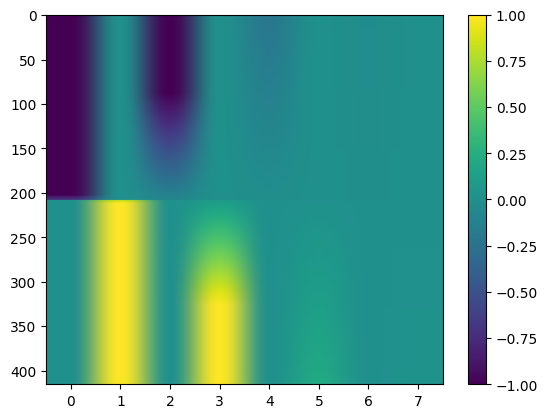

In [87]:
bar = plt.imshow(DM_time.todense(), aspect="auto", vmin=-1, vmax=1);
plt.colorbar(bar)

## Inspect Resdiuals after upscaling

In [34]:
import pandas as pd
import warnings

warnings.filterwarnings('ignore', category=RuntimeWarning)

In [177]:
bkgcube = BackgroundCube(
    sector=sector, camera=camera, ccd=ccd, img_bin=16, downsize="binning"
)
print(bkgcube)

TESS FFI Background object (Sector, Camera, CCD, N times): 2, 2, 4, 1245


In [178]:
bkgcube._get_dark_frame_idx()
bkgcube._get_star_mask(sigma=5.0, dilat_iter=2)
bkgcube._get_straps_mask()
static = bkgcube._get_static_scene()

Computing average static scene from darkes frames...


100%|██████████| 125/125 [03:41<00:00,  1.77s/it]


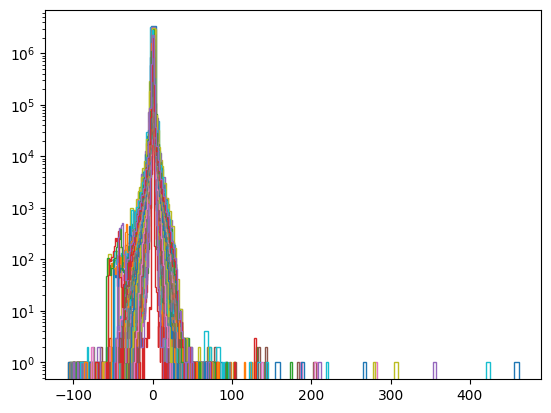

In [179]:
metrics = pd.DataFrame(columns=["mean", "std", "median", "mad", "rchi2", "skew", "kurtosis"])

step = binsize
row = np.arange(rmin, rmax, step)
col = np.arange(cmin, cmax, step)
eval_row = np.arange(rmin, rmax)
eval_col = np.arange(cmin, cmax)

bkgcube.bkg_pixels = ~bkgcube.star_mask
bkgcube.bkg_pixels &= ~bkgcube.strap_mask
mask_pixels = ~bkgcube.bkg_pixels

for tdx in tqdm(range(0, cube_sl_lin.shape[0], 10)):

    interp2d = RectBivariateSpline(col, row, cube_sl_lin[tdx] if fillnan else cube_sl[tdx])
    eval_sl = interp2d(eval_col, eval_row)
    
    raw = bkgcube.tcube.get_ffi(tdx)[1].data[
        bkgcube.rmin : bkgcube.rmax, bkgcube.cmin : bkgcube.cmax
    ]
    raw[mask_pixels] = np.nan
    current = raw - static

    metrics.loc[tdx, "mean"] = np.nanmean((current - eval_sl).ravel())
    metrics.loc[tdx, "std"] = np.nanstd((current - eval_sl).ravel())
    metrics.loc[tdx, "median"] = np.nanmedian((current - eval_sl).ravel())
    metrics.loc[tdx, "mad"] = stats.median_abs_deviation((current - eval_sl).ravel(), center=np.nanmedian, nan_policy="omit")

    zero_mask = current != 0
    metrics.loc[tdx, "rchi2"] = np.nansum((eval_sl[zero_mask] - current[zero_mask])** 2 / np.sqrt(current[zero_mask])) / np.multiply(*current.shape)
    metrics.loc[tdx, "skew"] = stats.skew((current - eval_sl).ravel(), nan_policy="omit")
    metrics.loc[tdx, "kurtosis"] = stats.kurtosis((current - eval_sl).ravel(), nan_policy="omit")

    plt.hist((current - eval_sl).ravel(), bins=100, log=True, histtype="step", lw=10)

    # break
plt.show()

In [180]:
metrics.to_csv(f"./data/residual_metrics_sl_bin{binsize}_sector{sector:03}_{camera}-{ccd}.csv")

In [46]:
metrics8 = pd.read_csv(f"./data/residual_metrics_sl_bin8_sector{sector:03}_{camera}-{ccd}.csv")
metrics16 = pd.read_csv(f"./data/residual_metrics_sl_bin16_sector{sector:03}_{camera}-{ccd}.csv")

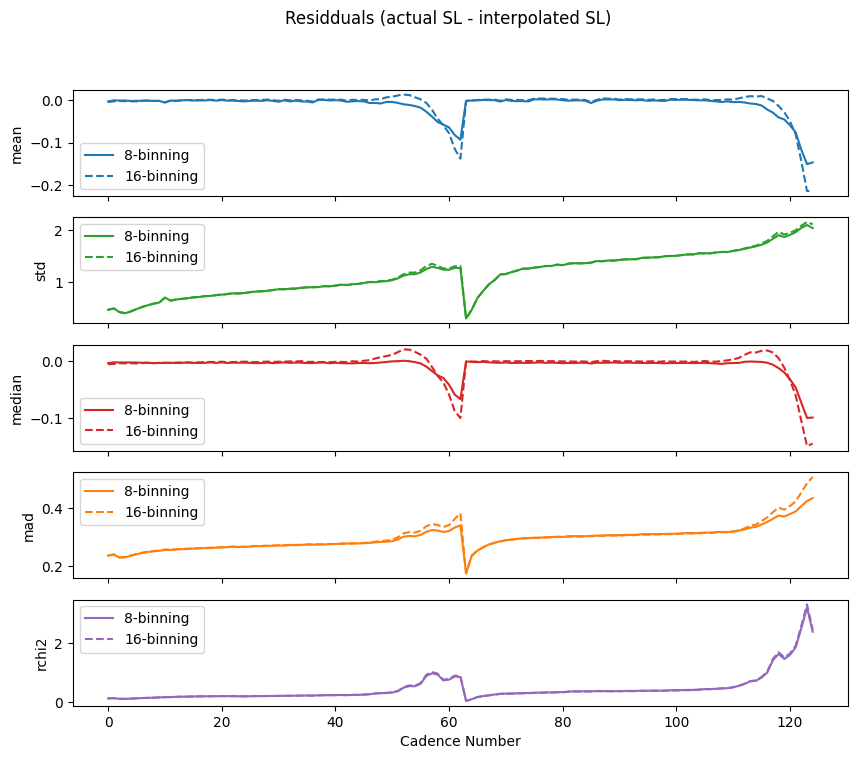

In [47]:
cols = ["mean", "std", "median", "mad", "rchi2"]
colors = ["tab:blue", "tab:green", "tab:red", "tab:orange", "tab:purple"]
fig, ax = plt.subplots(len(cols), 1, figsize=(len(cols)*2, 8), sharex=True)
for k, c in enumerate(cols):
    ax[k].plot(metrics8[c], c=colors[k], ls="-", label="8-binning")
    ax[k].plot(metrics16[c], c=colors[k], ls="--", label="16-binning")
    ax[k].set_ylabel(c)
    ax[k].legend()

ax[-1].set_xlabel("Cadence Number")
fig.suptitle(f"Residduals (actual SL - interpolated SL)")
plt.show()

## Correct Scatter Light in FFI light curves

TOIs in this Sector/Camera/CCD

| TIC       | Camera | CCD | TOI Disposition | RA | Dec | TMag |
|-----------|--------|-----|-----------------|----|-----|------|
| 144440290 | 2 | 4 |	EB | 359.161519 | -44.719088 | 8.723  |
| 183537452 | 2 | 4 |	KP | 357.879533 | -39.906726 | 10.195 |
| 183985250 | 2 | 4 |	CP | 358.667547 | -37.628020 | 9.098  |
| 184240683 | 2 | 4 |	KP | 359.348992 | -41.277150 | 11.502 |
| 224225541 | 2 | 4 |	CP | 353.061818 | -37.255890 | 9.307  |
| 402026209 | 2 | 4 |	KP | 353.562839 | -42.061409 | 11.778 |


In [35]:
from tesscube import TESSCube
from astropy.coordinates import SkyCoord
import astropy.units as u
from astropy.io import fits
from scipy import ndimage
from glob import glob
import os

In [36]:
tois = pd.DataFrame(
    [
        [144440290, 2, 4, "EB", 359.161519, -44.719088, 8.723],
        [183537452, 2, 4, "KP", 357.879533, -39.906726, 10.195],
        [183985250, 2, 4, "CP", 358.667547, -37.628020, 9.098],
        [184240683, 2, 4, "KP", 359.348992, -41.277150, 11.502],
        [224225541, 2, 4, "CP", 353.061818, -37.255890, 9.307],
        [402026209, 2, 4, "KP", 353.562839, -42.061409, 11.778,]
    ],
    columns=["TIC", "camera", "ccd", "disposition","ra", "dec","tmag"]
)
tois

,TIC,camera,ccd,disposition,ra,dec,tmag
0,144440290,2,4,EB,359.161519,-44.719088,8.723
1,183537452,2,4,KP,357.879533,-39.906726,10.195
2,183985250,2,4,CP,358.667547,-37.628020,9.098
3,184240683,2,4,KP,359.348992,-41.277150,11.502
4,224225541,2,4,CP,353.061818,-37.255890,9.307
5,402026209,2,4,KP,353.562839,-42.061409,11.778


In [37]:
tics = pd.read_csv(f"./data/all_targets_S{sector:03}_v1.csv", skiprows=5).query(f"Camera == {camera} and CCD == {ccd}")
tics = tics.rename(columns={"TICID":"TIC", "RA": "ra", "Dec": "dec"})
tics

,TIC,Camera,CCD,Tmag,ra,dec
126,7129031,2,4,9.86,3.9531,-44.1077
127,7129680,2,4,10.51,4.1044,-43.3082
128,7129726,2,4,9.08,4.2241,-43.5406
129,7129788,2,4,8.66,4.1466,-43.8581
134,7144448,2,4,8.19,4.3010,-44.3644
...,...,...,...,...,...,...
15575,425864422,2,4,8.16,352.1221,-44.5869
15576,425864448,2,4,8.12,352.0632,-44.4626
15577,425864469,2,4,10.63,352.0835,-44.3856
15920,469914888,2,4,9.87,350.4189,-49.0417


In [38]:
flist = sorted(glob(f"./data/tic_*_sector{sector}_{camera}-{ccd}.fits"))
plot_ids = np.array([int(float(x.split("_")[1])) for x in flist])
tics_plot = tics[np.isin(tics.TIC.values, plot_ids)].sort_values("TIC")

In [39]:
tcube = TESSCube(sector=sector, camera=camera, ccd=ccd)

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


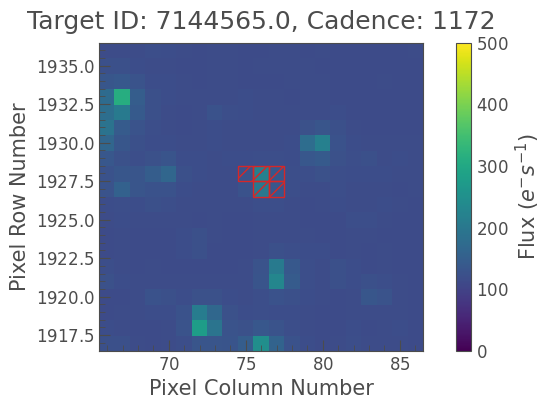

100%|██████████| 1245/1245 [00:11<00:00, 112.85it/s]


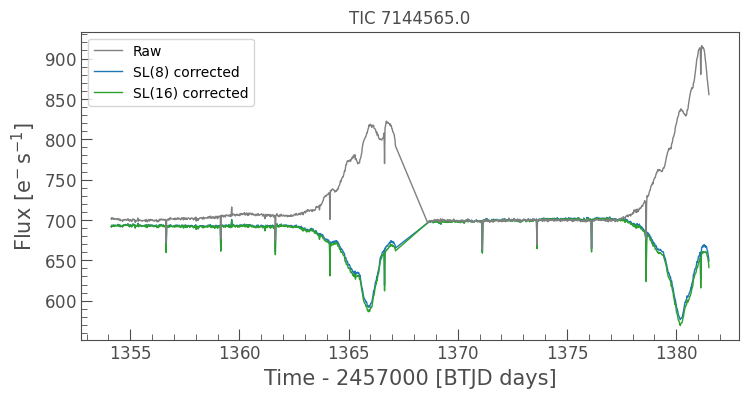

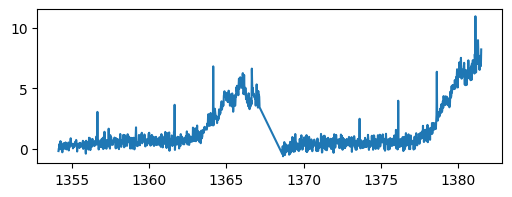

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


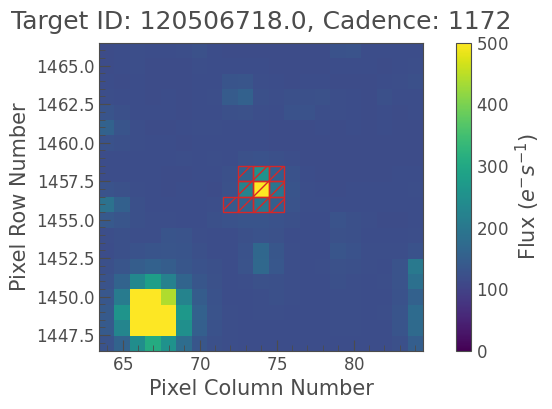

100%|██████████| 1245/1245 [00:10<00:00, 114.75it/s]


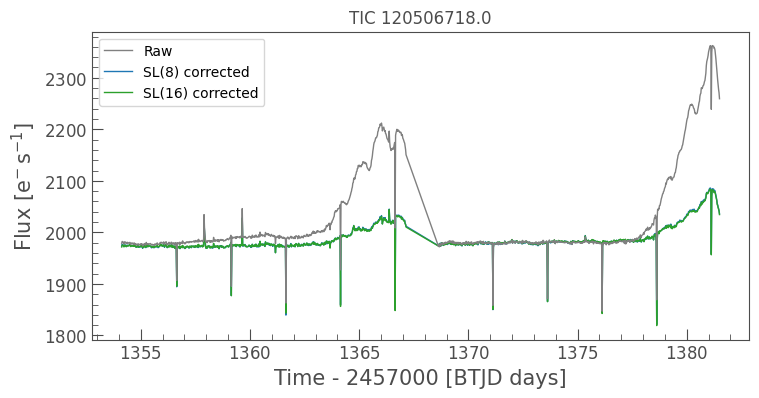

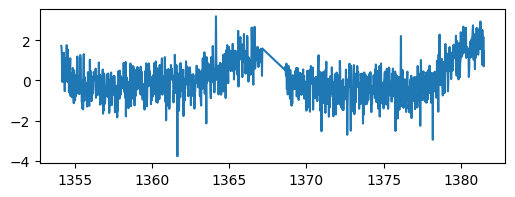

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


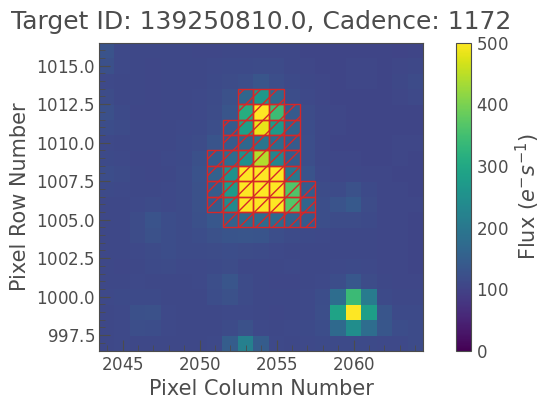

100%|██████████| 1245/1245 [00:10<00:00, 114.81it/s]


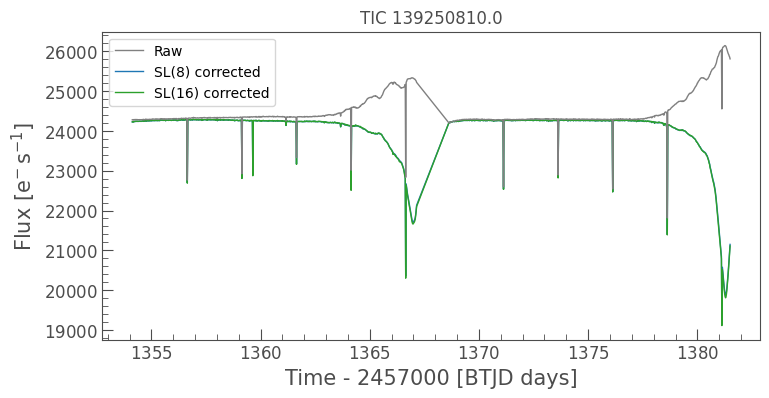

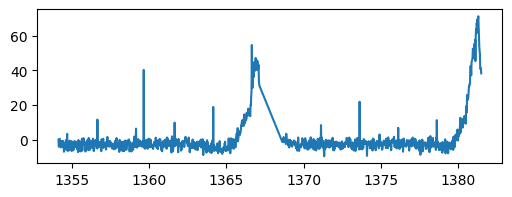

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


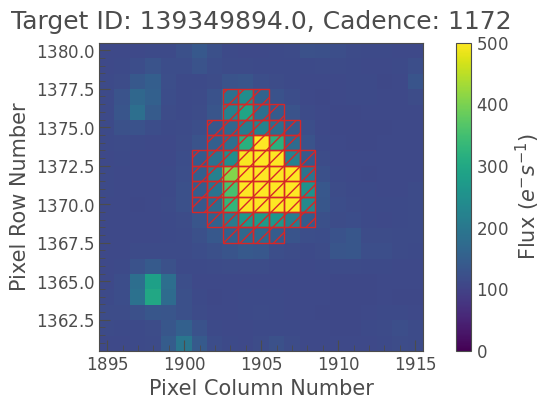

100%|██████████| 1245/1245 [00:11<00:00, 112.99it/s]


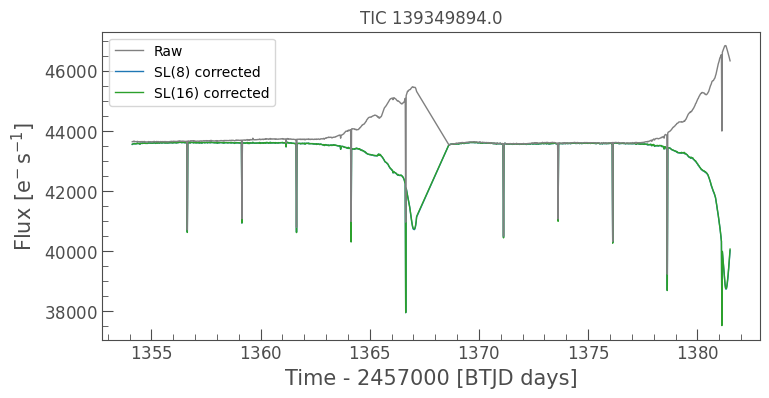

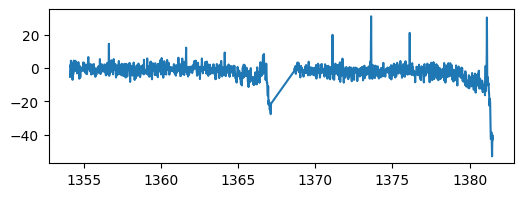

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


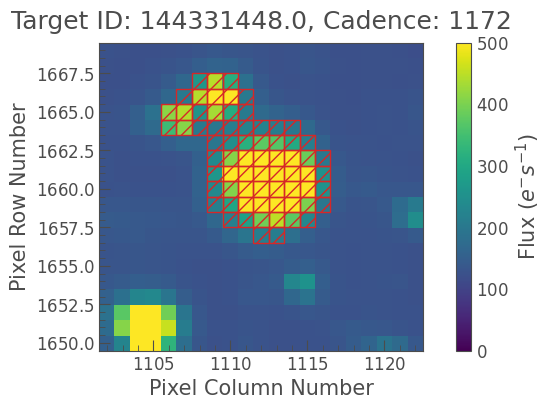

100%|██████████| 1245/1245 [00:10<00:00, 115.30it/s]


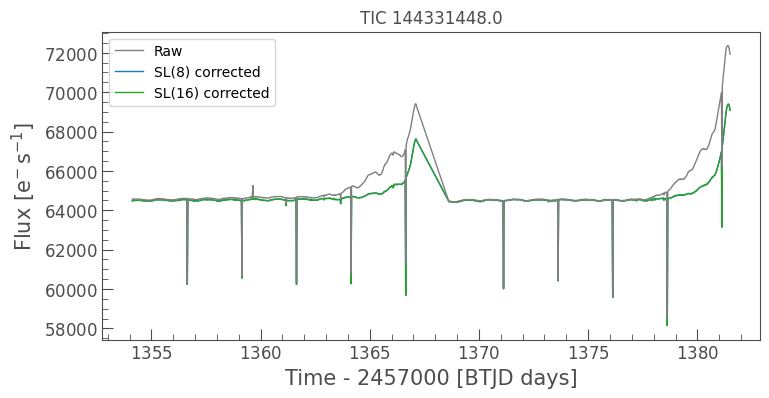

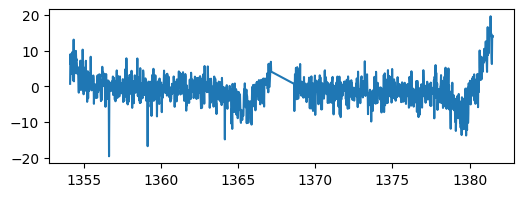

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


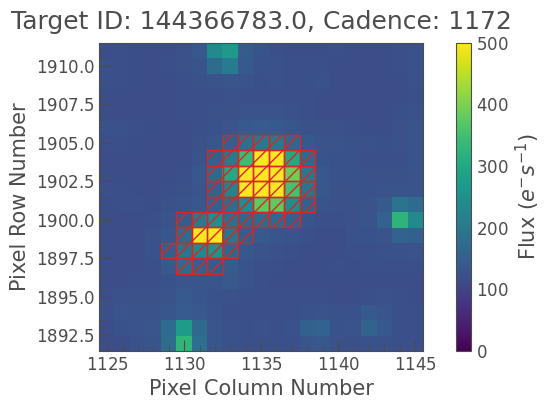

100%|██████████| 1245/1245 [00:11<00:00, 113.08it/s]


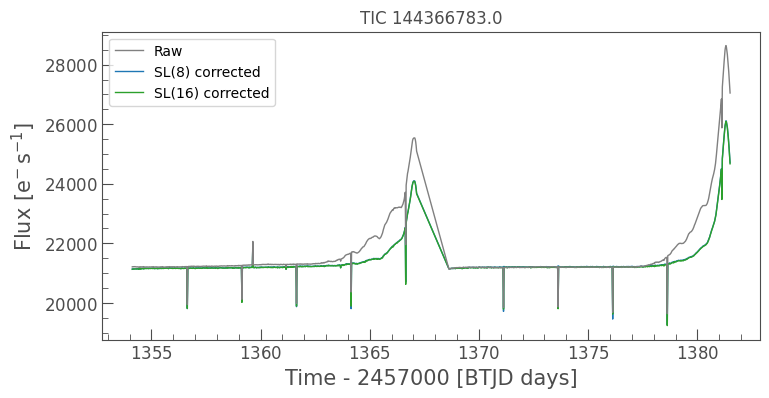

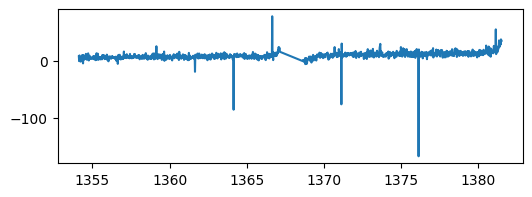

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


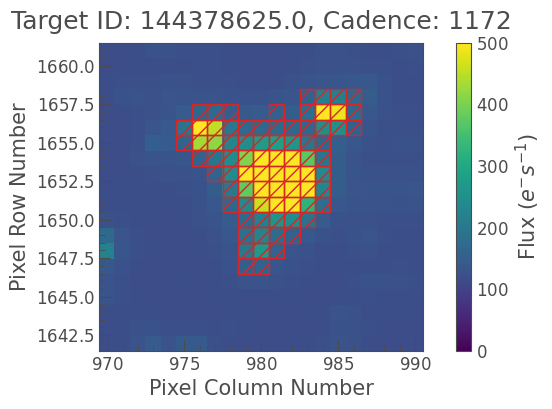

100%|██████████| 1245/1245 [00:10<00:00, 113.47it/s]


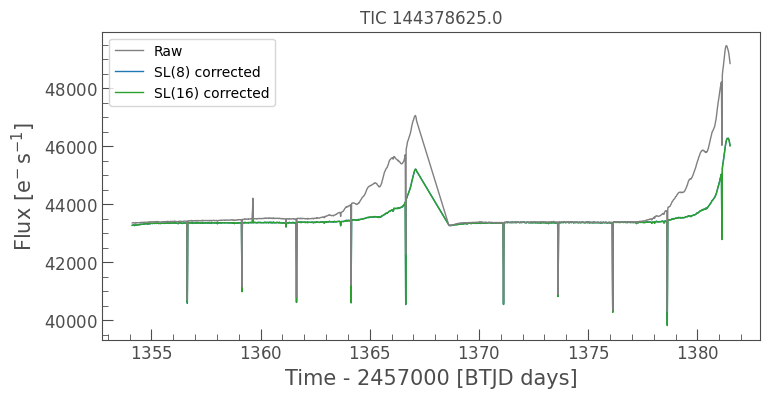

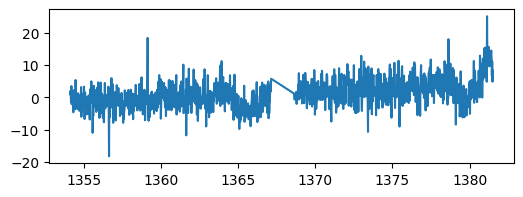

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


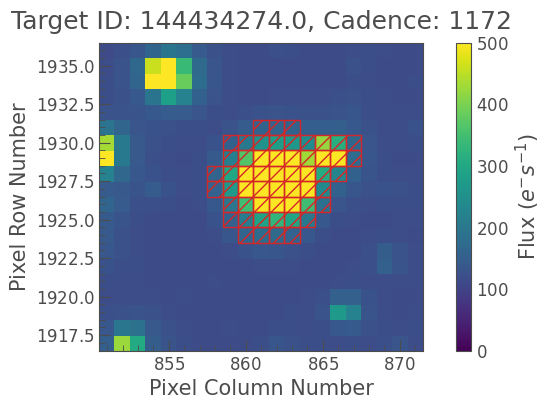

100%|██████████| 1245/1245 [00:11<00:00, 111.29it/s]


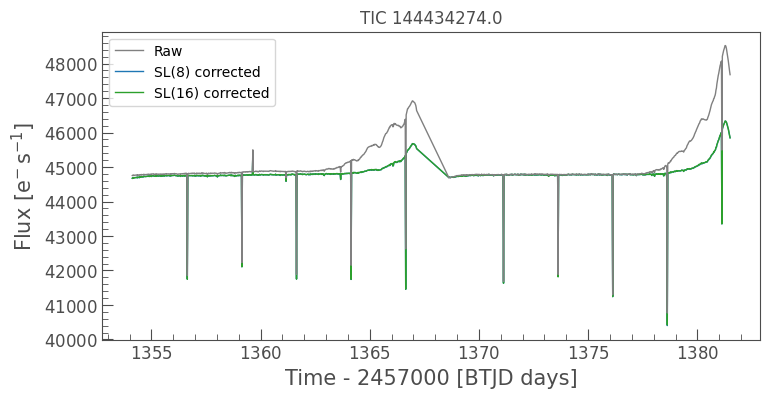

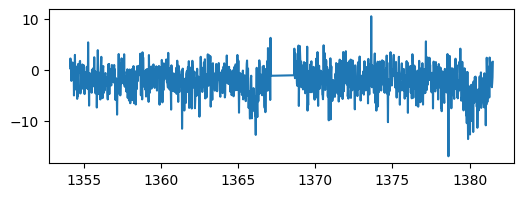

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


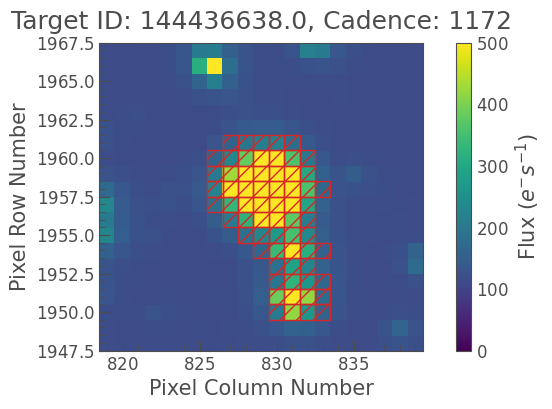

100%|██████████| 1245/1245 [00:10<00:00, 114.08it/s]


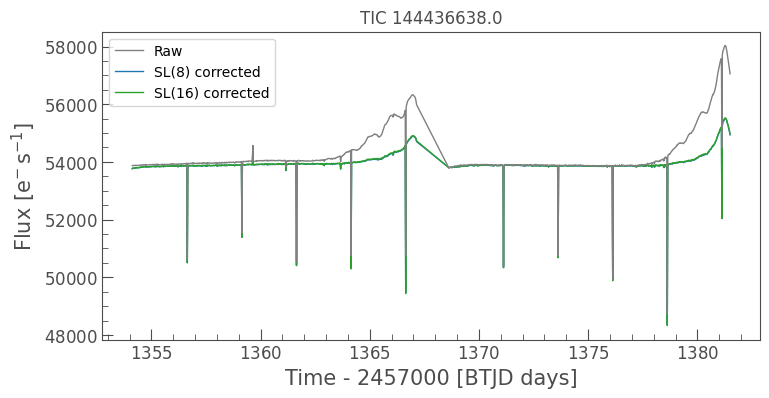

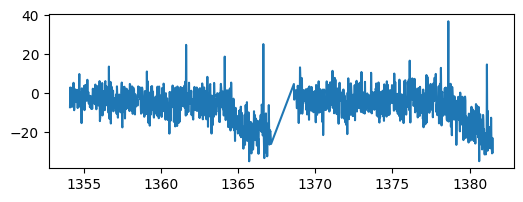

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


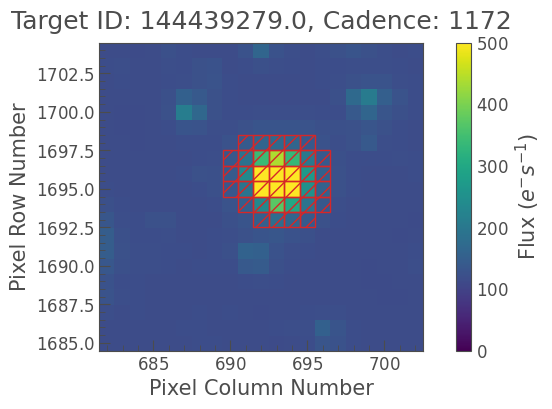

100%|██████████| 1245/1245 [00:10<00:00, 114.00it/s]


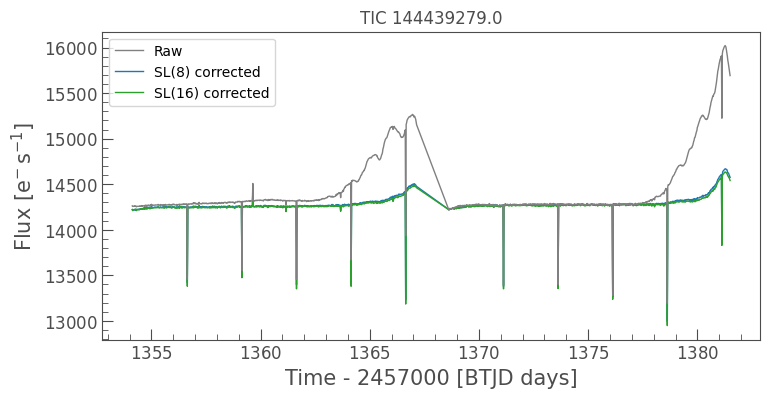

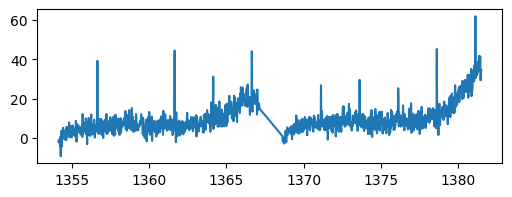

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


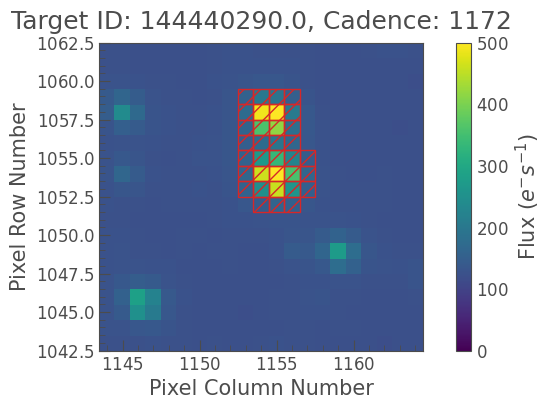

100%|██████████| 1245/1245 [00:11<00:00, 113.13it/s]


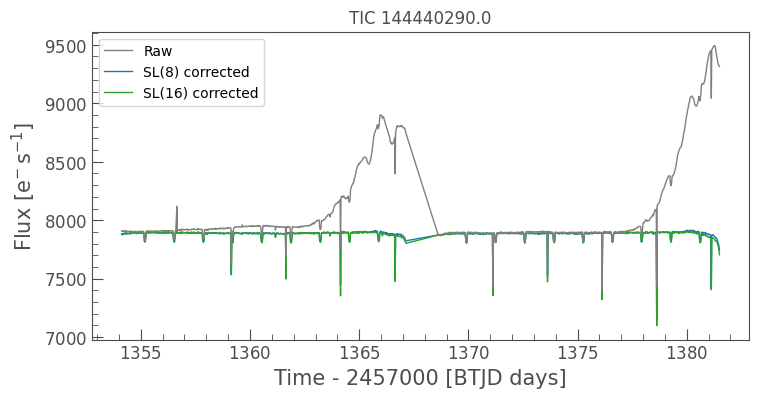

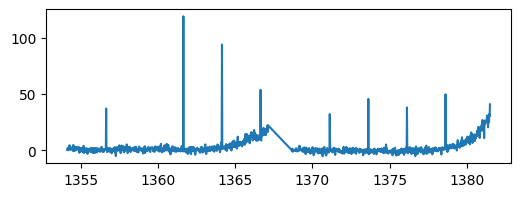

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


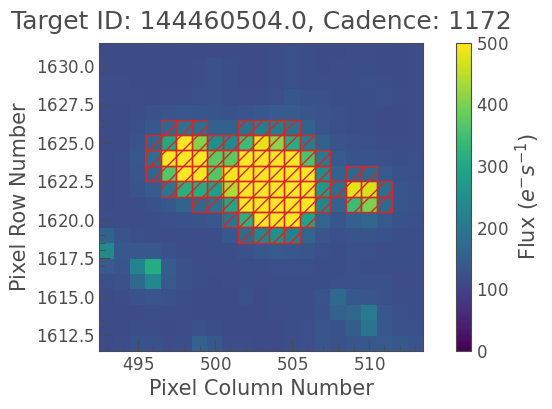

100%|██████████| 1245/1245 [00:10<00:00, 114.27it/s]


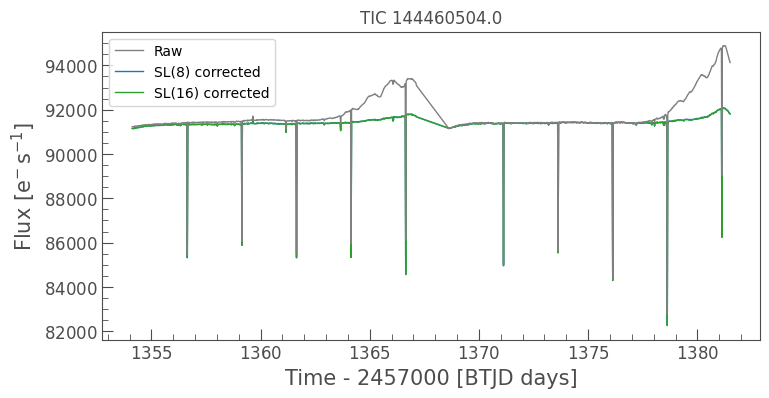

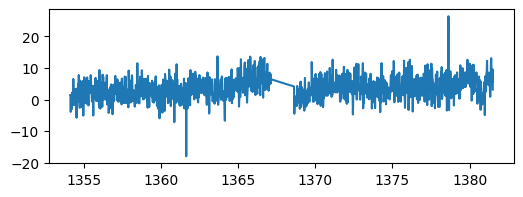

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


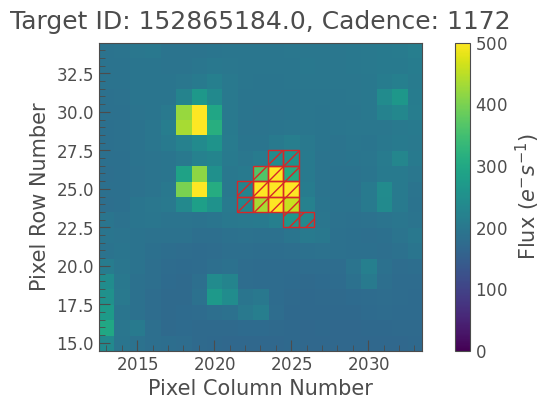

100%|██████████| 1245/1245 [00:10<00:00, 113.64it/s]


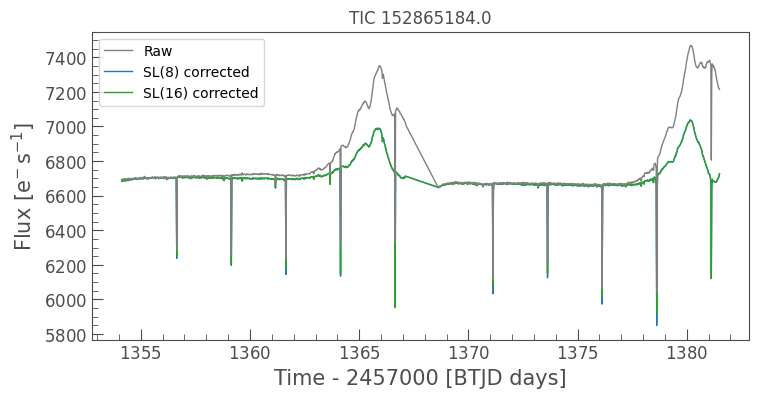

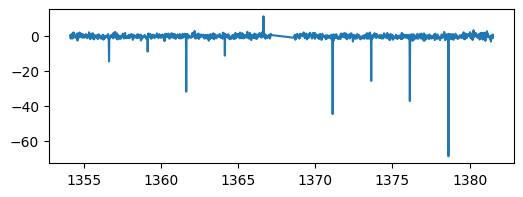

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


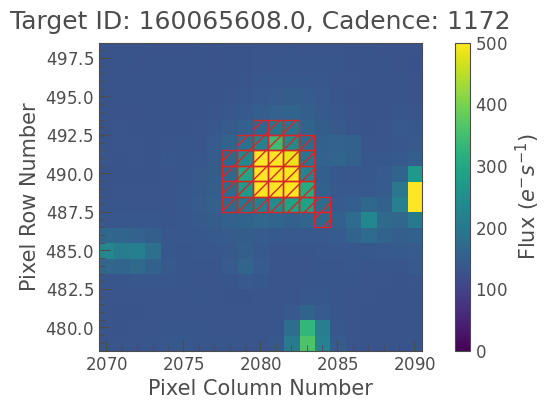

100%|██████████| 1245/1245 [00:11<00:00, 111.81it/s]


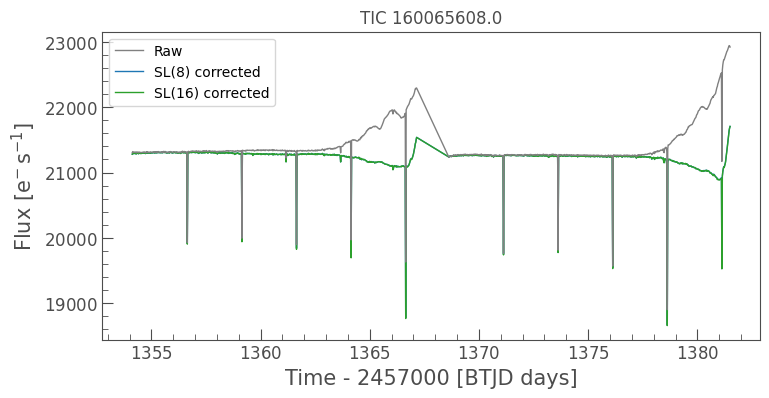

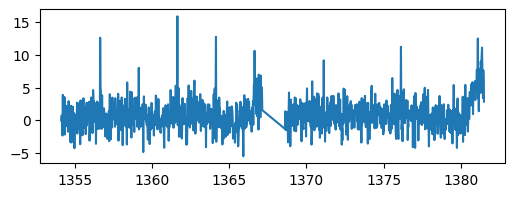

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


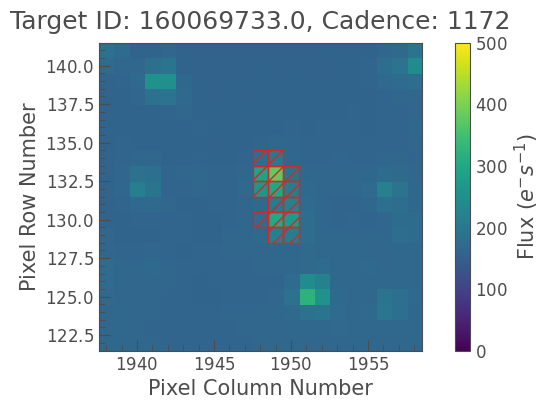

100%|██████████| 1245/1245 [00:10<00:00, 114.30it/s]


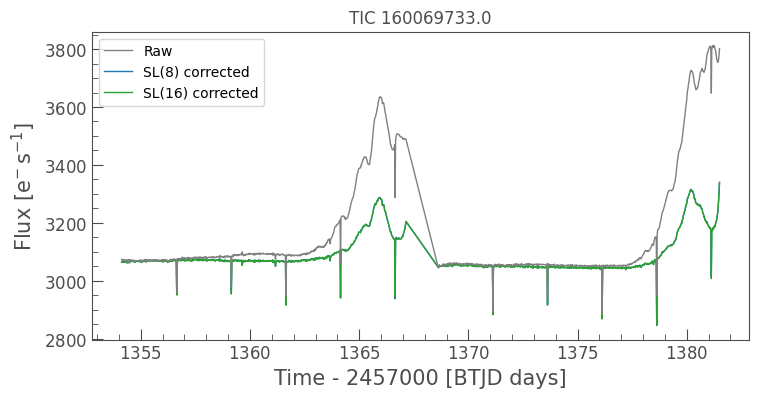

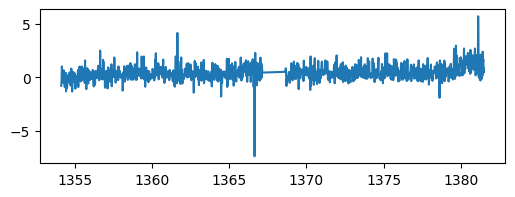

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


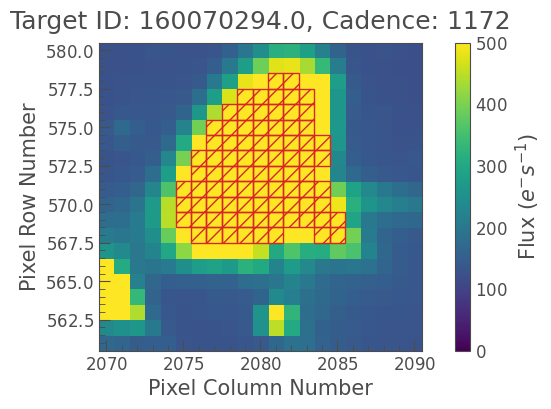

100%|██████████| 1245/1245 [00:11<00:00, 111.82it/s]


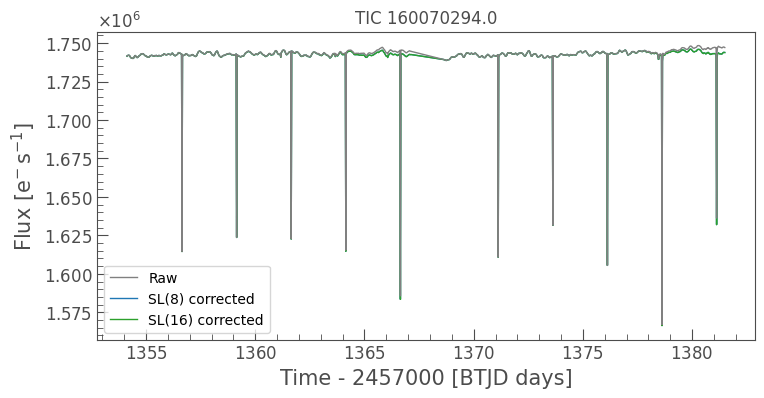

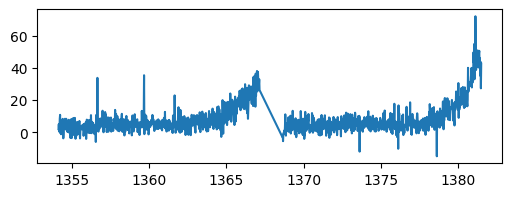

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


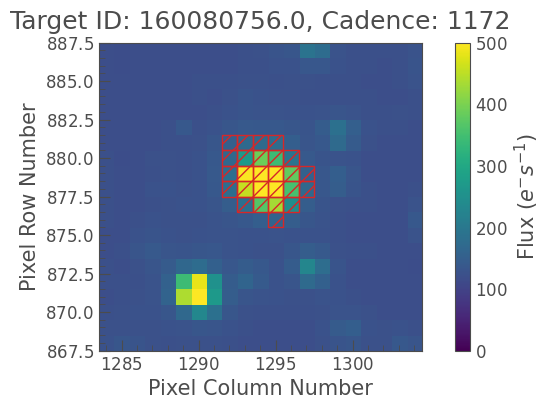

100%|██████████| 1245/1245 [00:11<00:00, 111.89it/s]


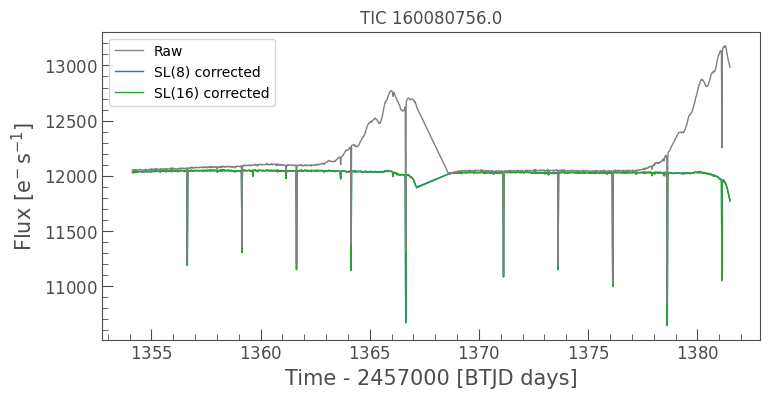

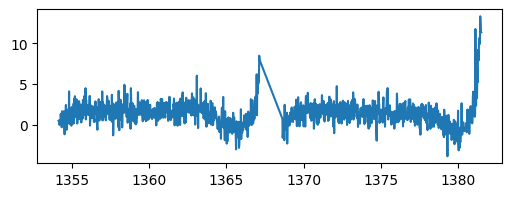

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


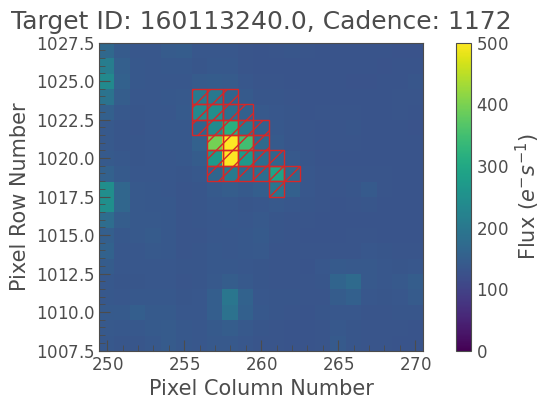

100%|██████████| 1245/1245 [00:10<00:00, 115.04it/s]


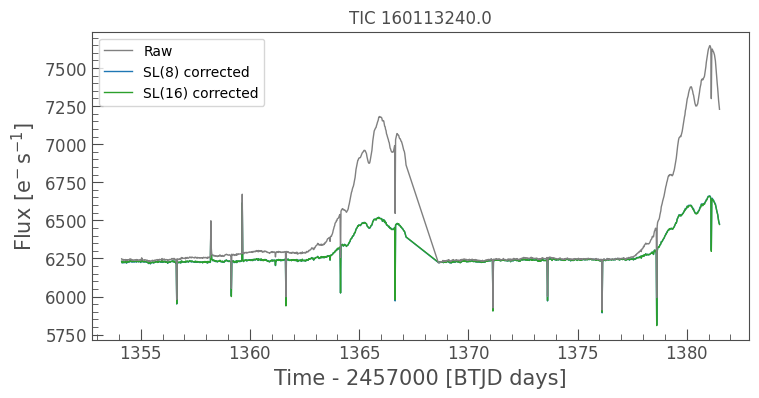

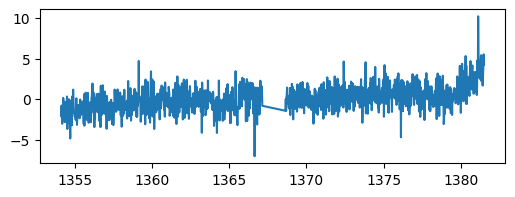

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


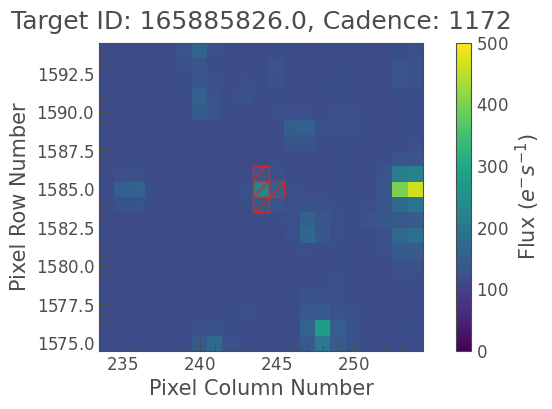

100%|██████████| 1245/1245 [00:10<00:00, 116.10it/s]


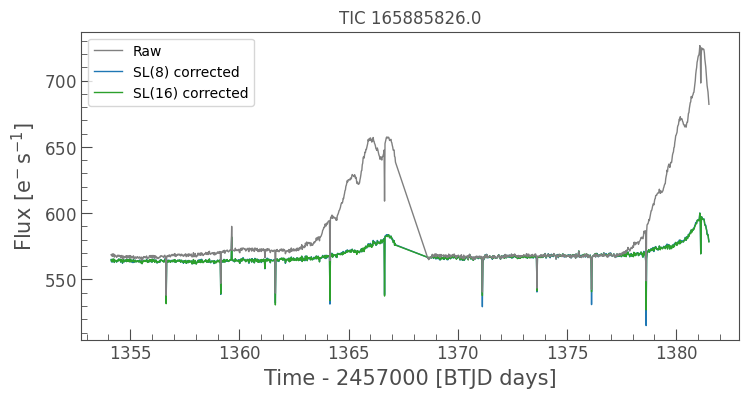

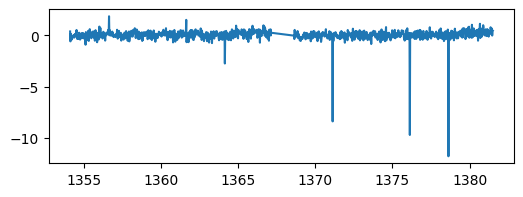

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


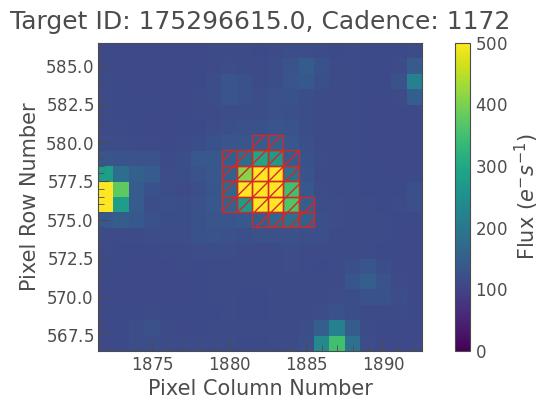

100%|██████████| 1245/1245 [00:11<00:00, 111.13it/s]


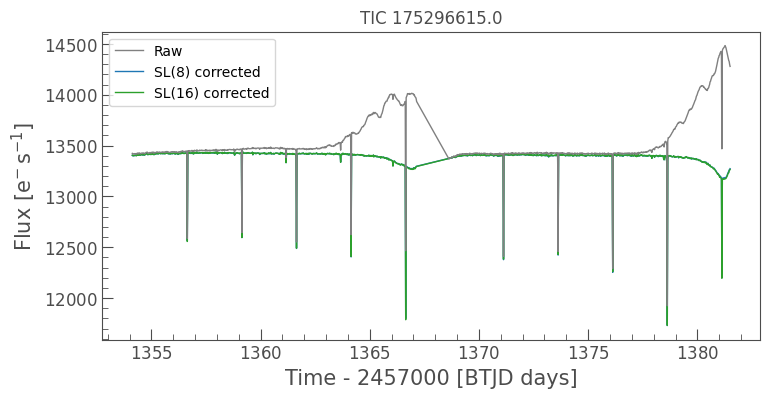

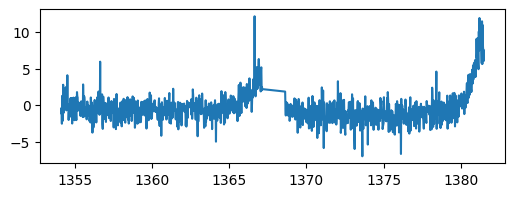

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


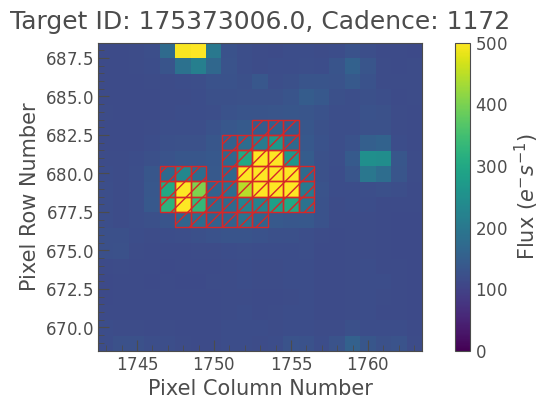

100%|██████████| 1245/1245 [00:11<00:00, 112.71it/s]


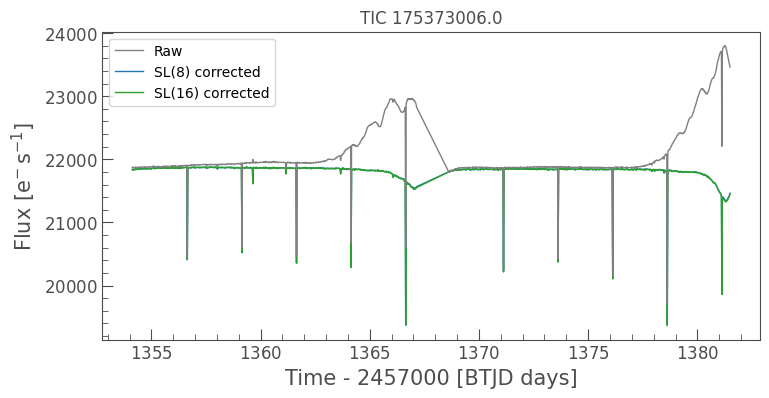

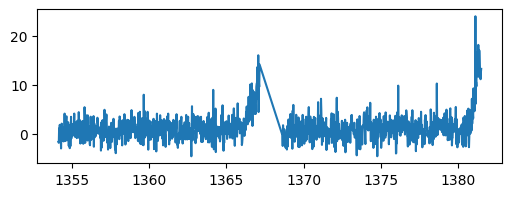

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


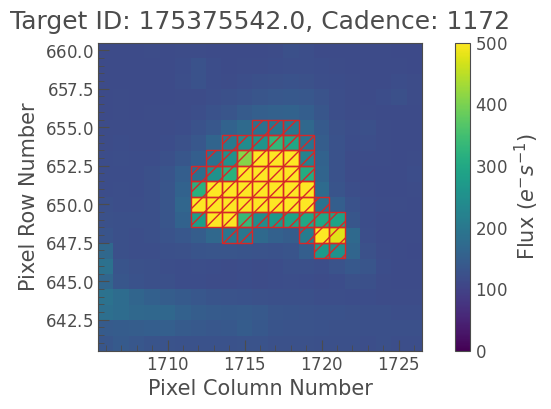

100%|██████████| 1245/1245 [00:10<00:00, 113.92it/s]


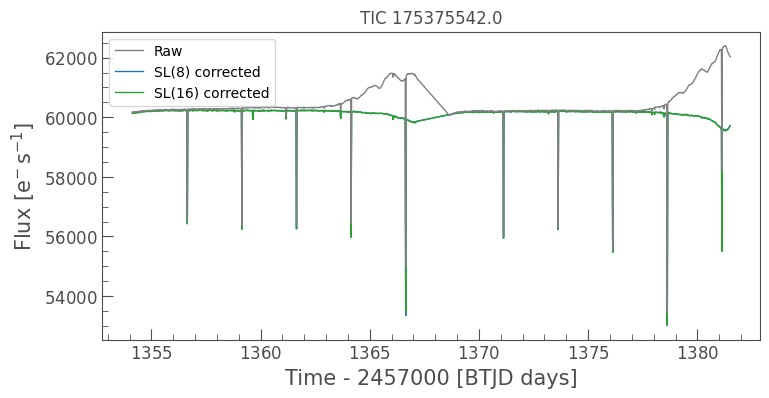

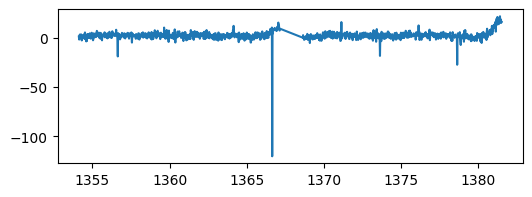

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


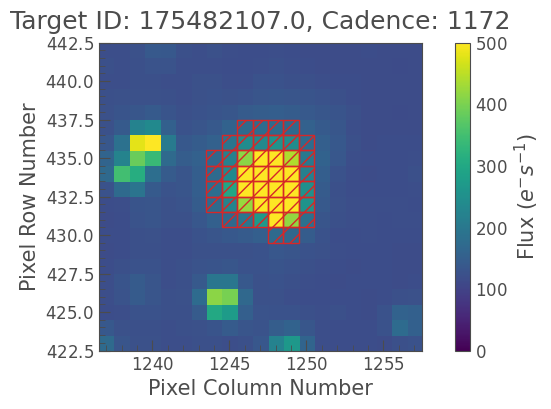

100%|██████████| 1245/1245 [00:11<00:00, 108.99it/s]


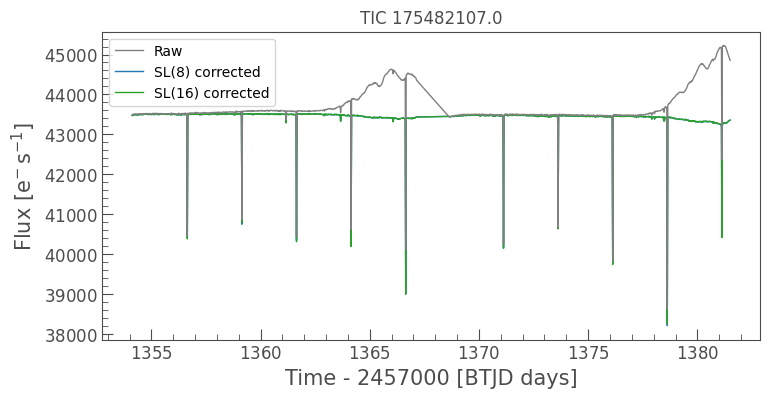

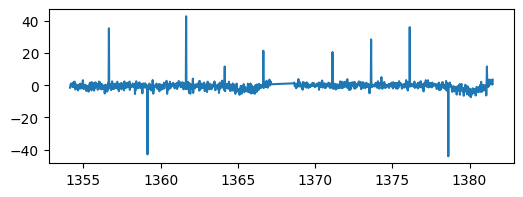

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


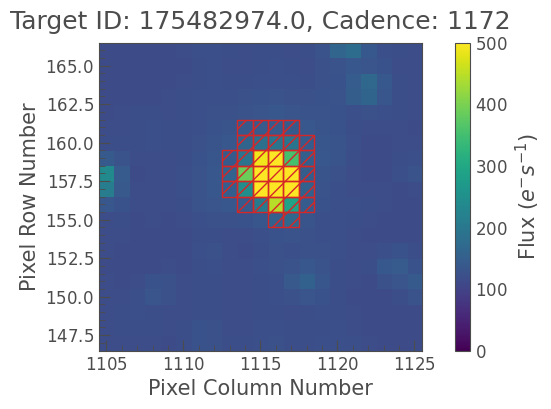

100%|██████████| 1245/1245 [00:10<00:00, 114.04it/s]


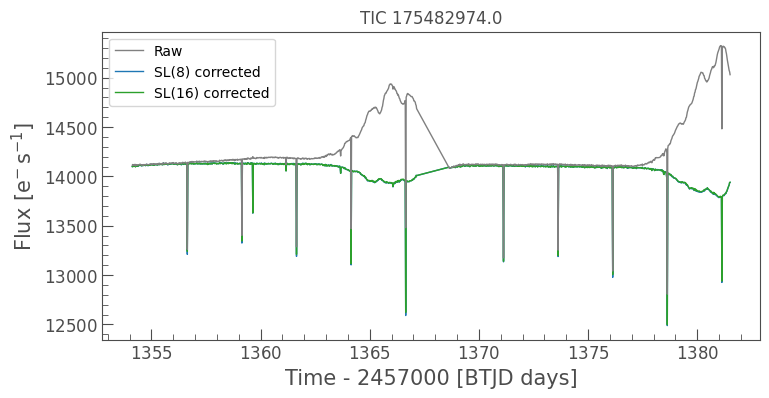

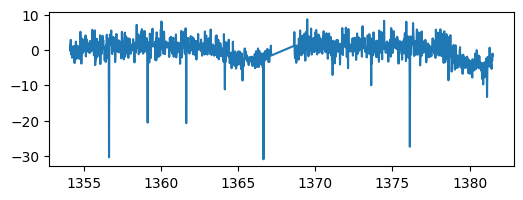

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


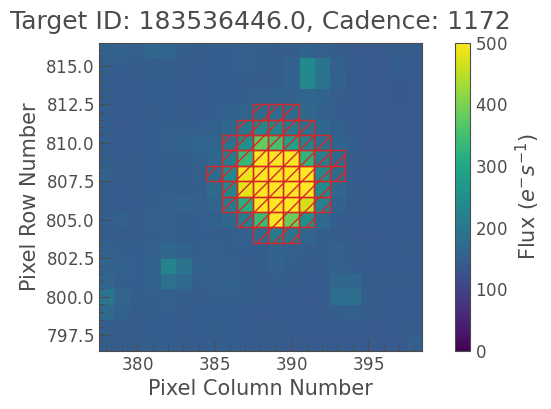

100%|██████████| 1245/1245 [00:10<00:00, 115.23it/s]


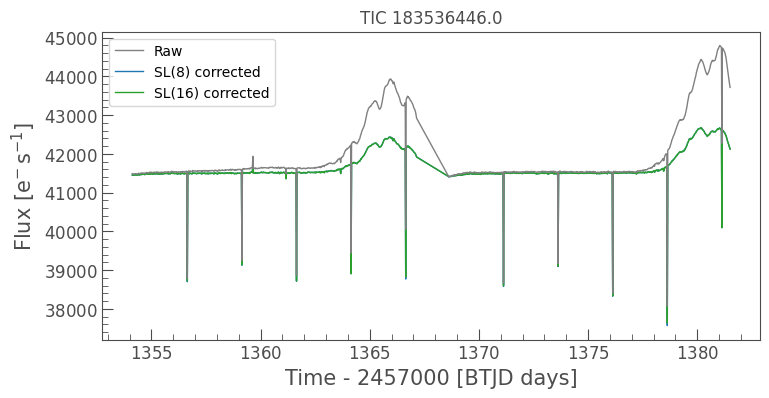

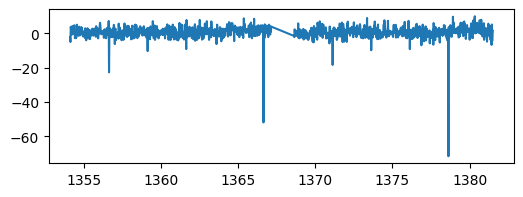

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


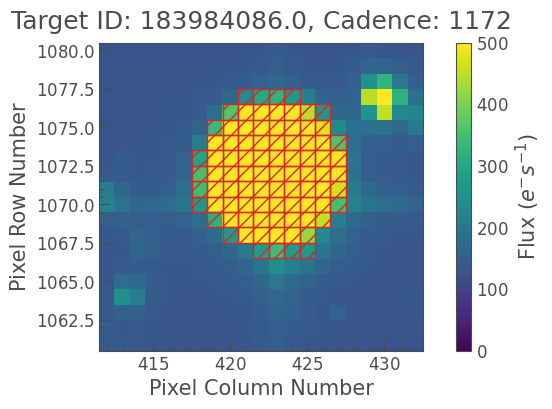

100%|██████████| 1245/1245 [00:10<00:00, 113.41it/s]


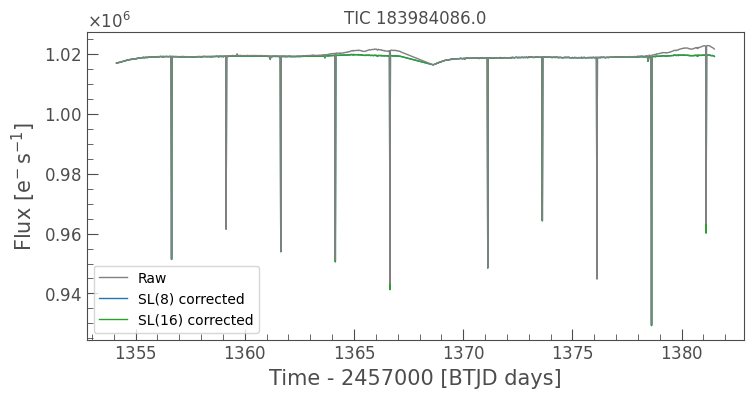

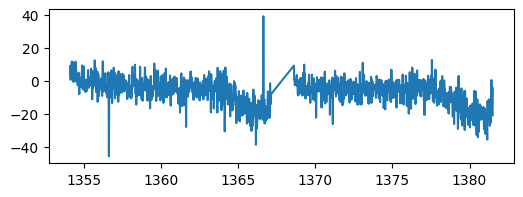

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


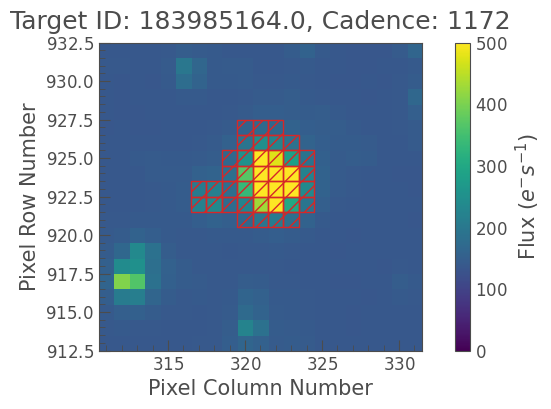

100%|██████████| 1245/1245 [00:10<00:00, 113.59it/s]


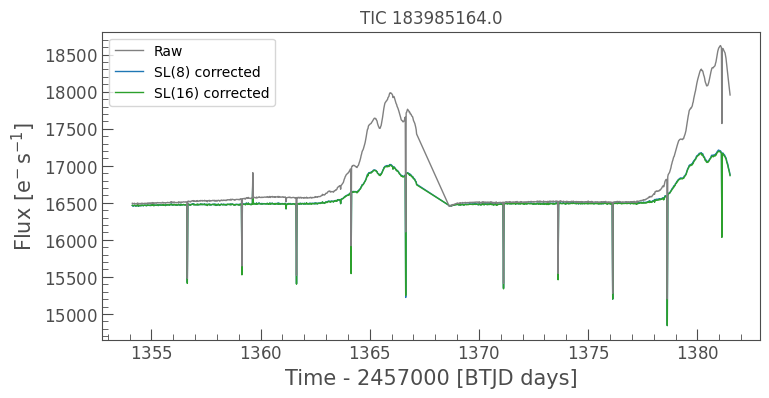

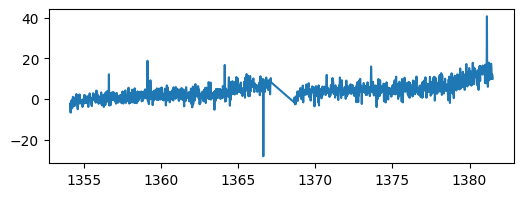

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


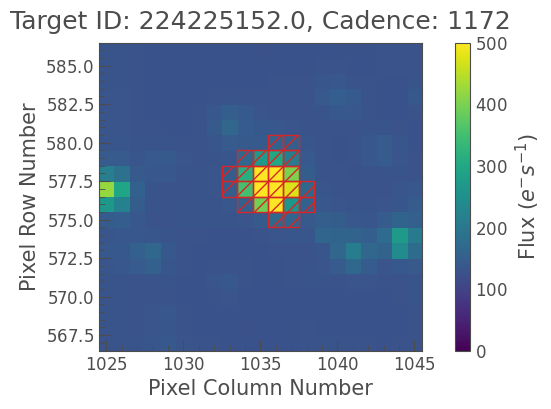

100%|██████████| 1245/1245 [00:10<00:00, 113.89it/s]


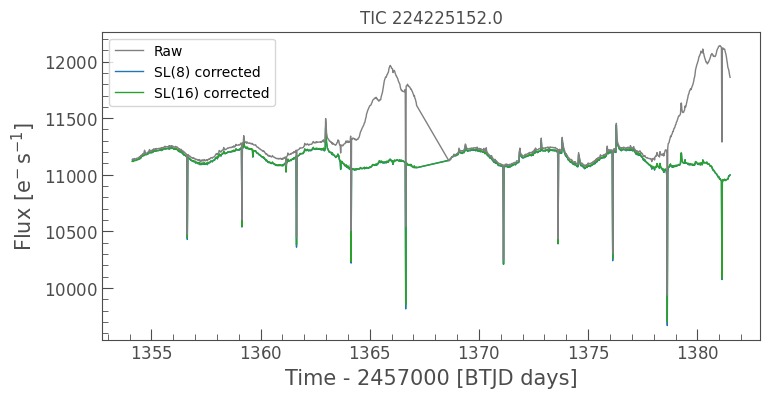

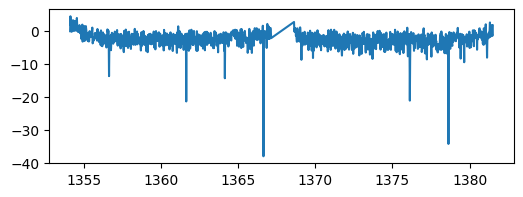

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


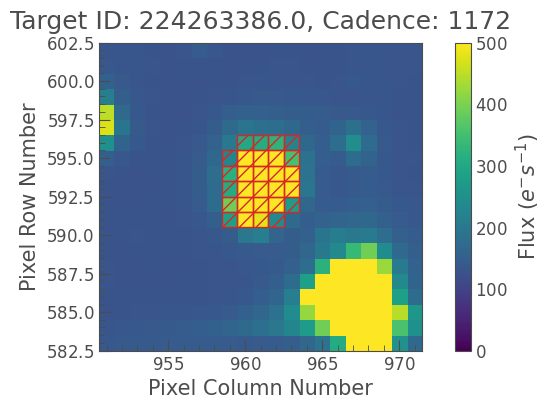

100%|██████████| 1245/1245 [00:10<00:00, 115.51it/s]


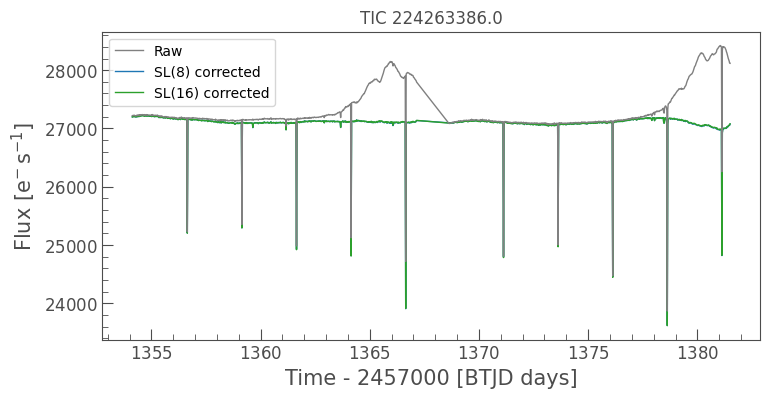

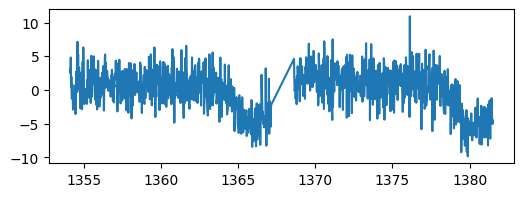

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


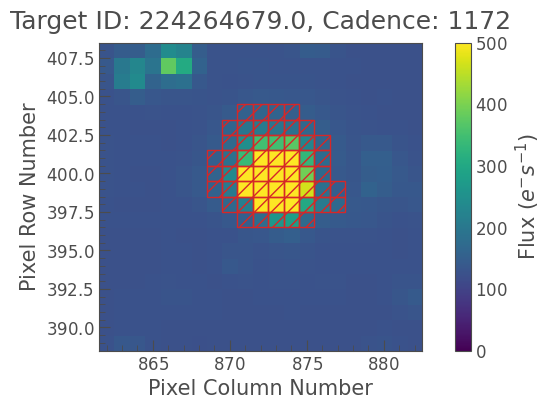

100%|██████████| 1245/1245 [00:11<00:00, 110.25it/s]


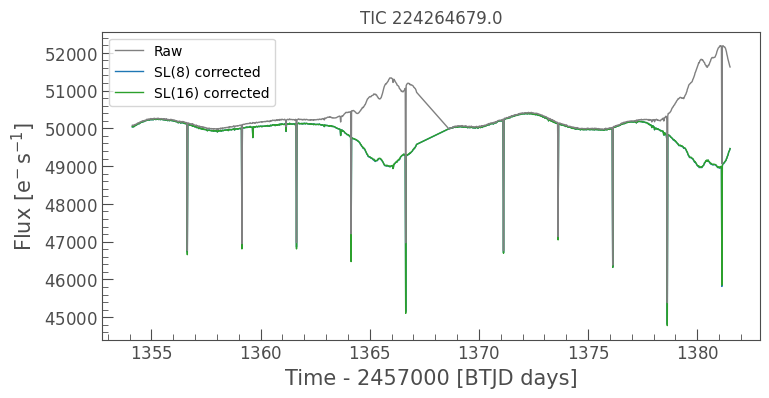

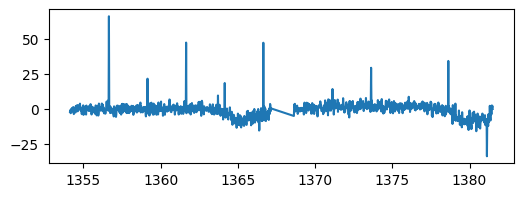

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


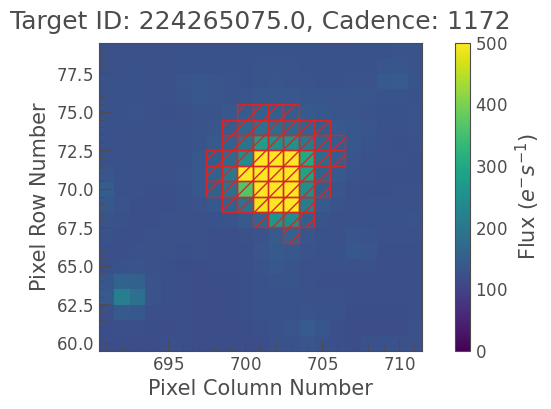

100%|██████████| 1245/1245 [00:11<00:00, 108.27it/s]


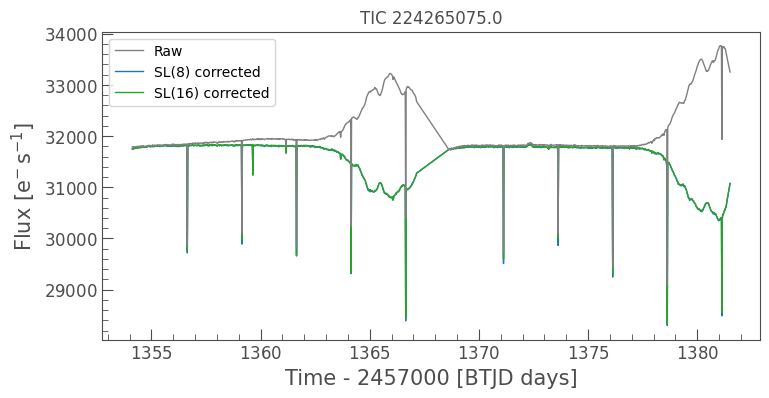

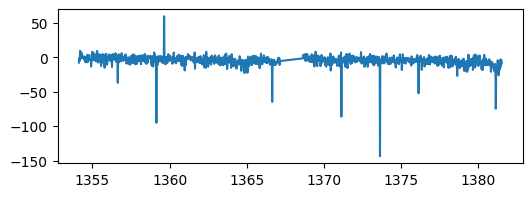

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


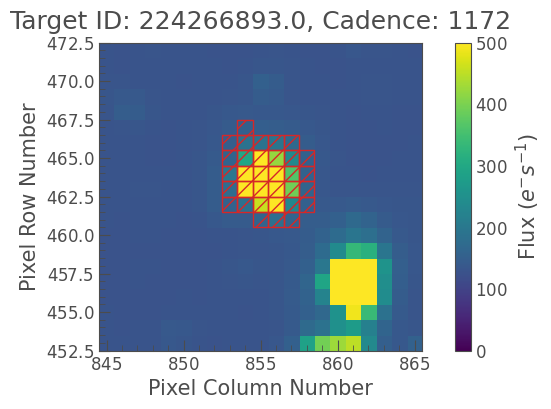

100%|██████████| 1245/1245 [00:10<00:00, 115.51it/s]


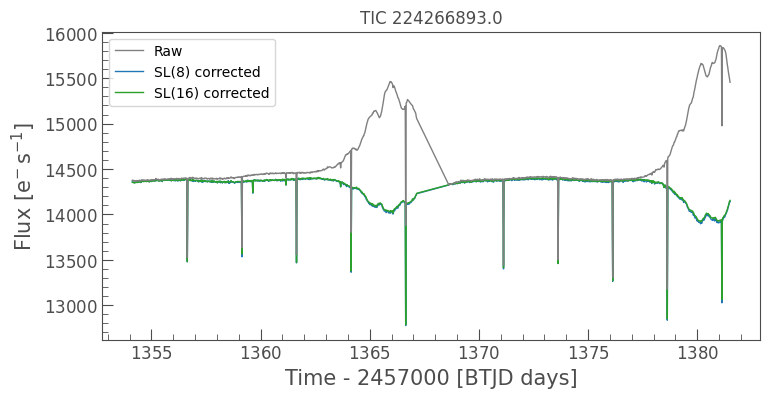

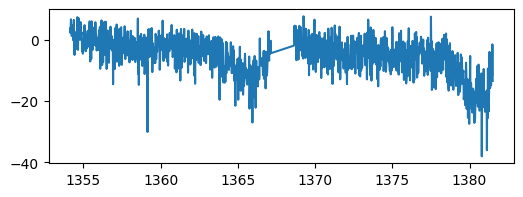

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


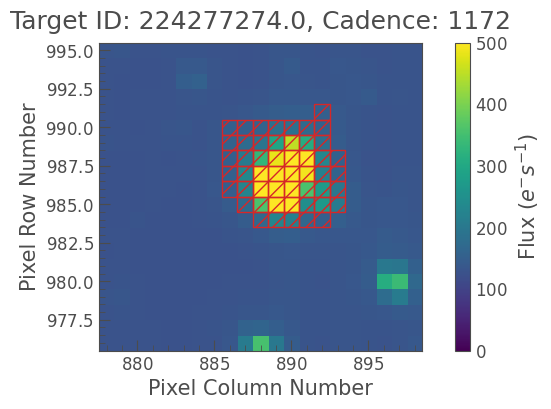

100%|██████████| 1245/1245 [00:11<00:00, 113.01it/s]


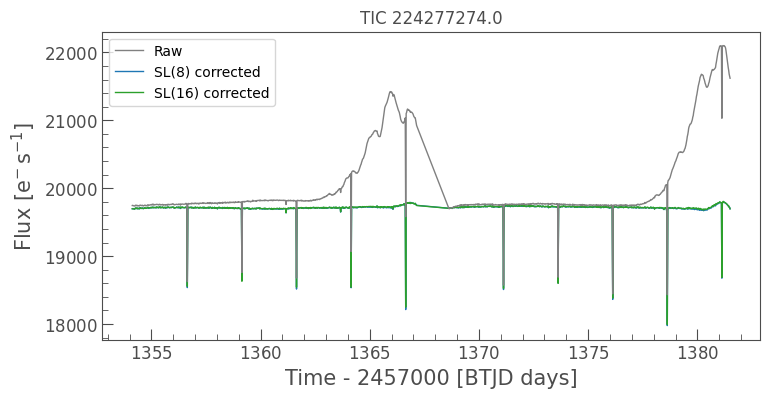

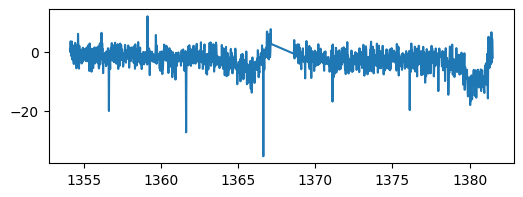

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


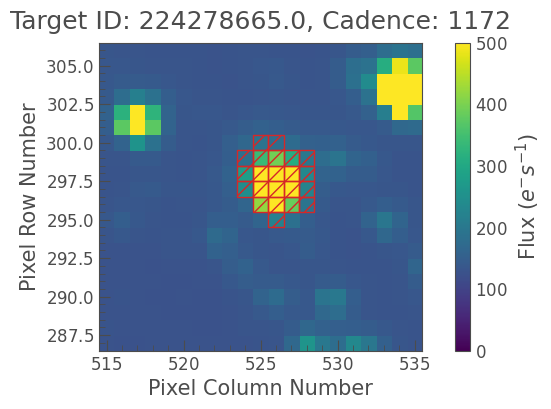

100%|██████████| 1245/1245 [00:10<00:00, 115.03it/s]


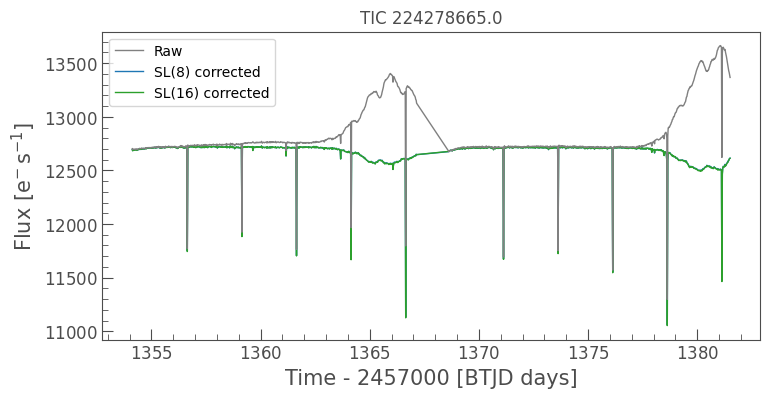

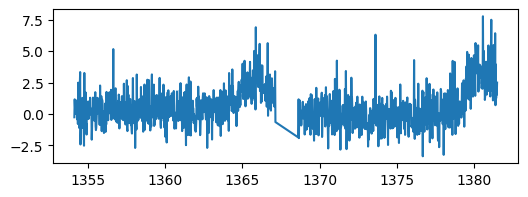

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


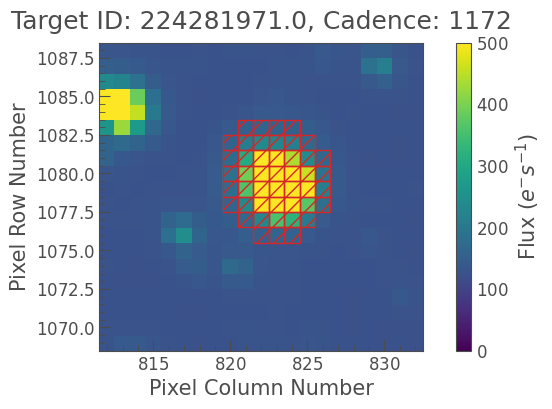

100%|██████████| 1245/1245 [00:11<00:00, 111.01it/s]


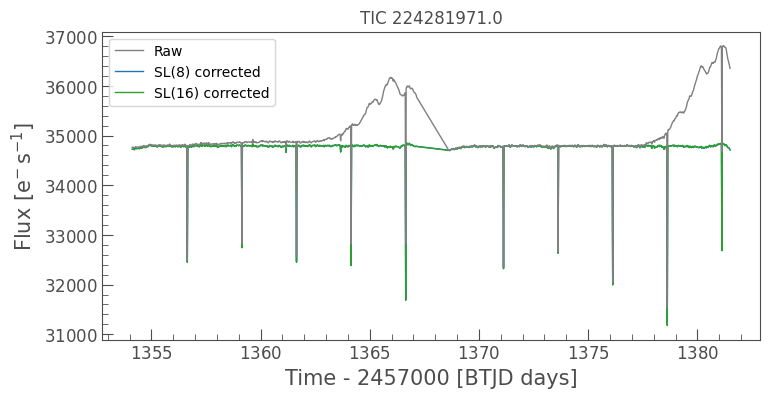

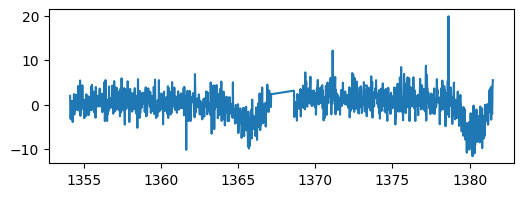

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


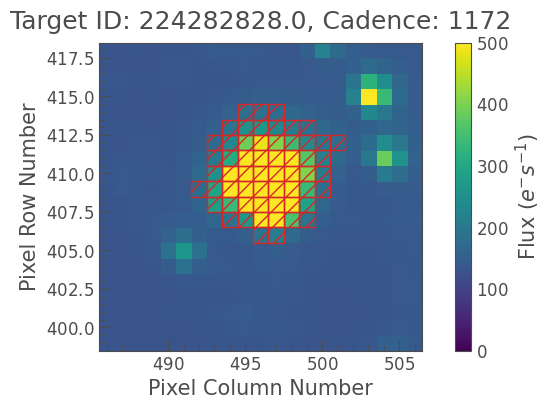

100%|██████████| 1245/1245 [00:10<00:00, 114.33it/s]


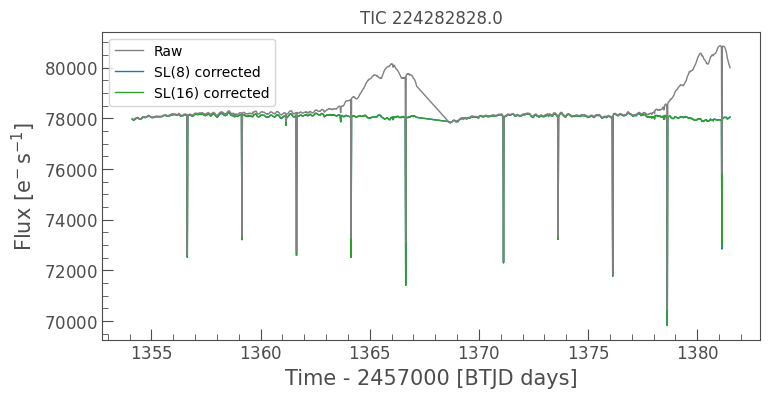

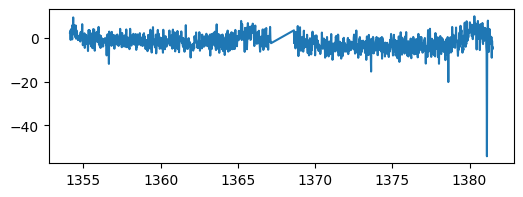

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


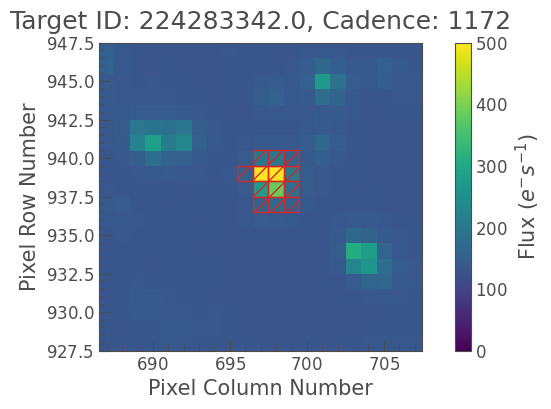

100%|██████████| 1245/1245 [00:10<00:00, 114.51it/s]


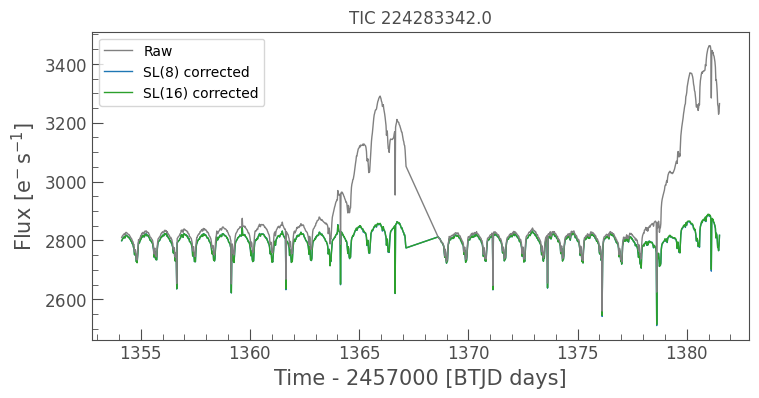

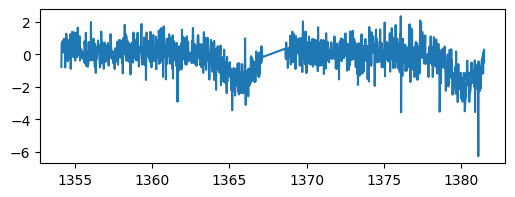

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


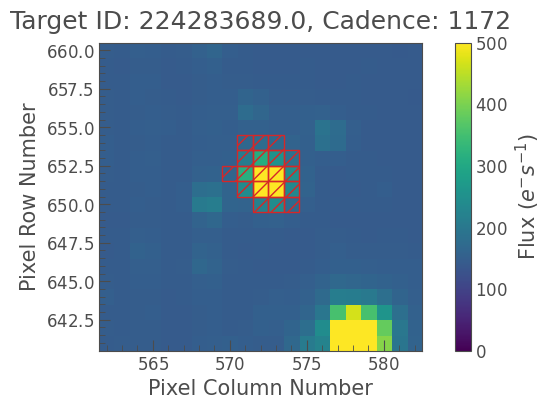

100%|██████████| 1245/1245 [00:16<00:00, 73.87it/s]


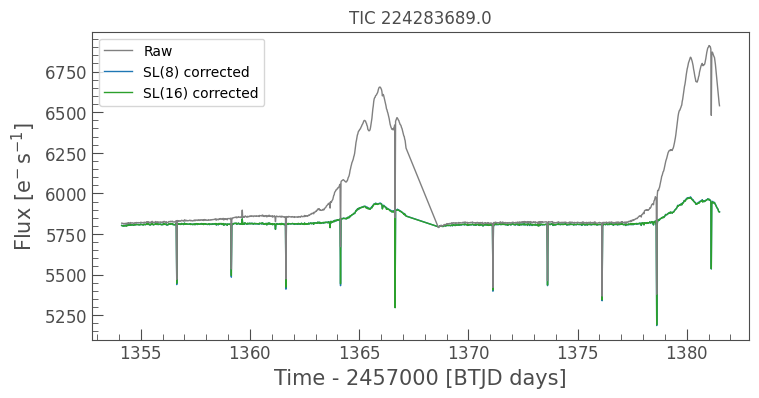

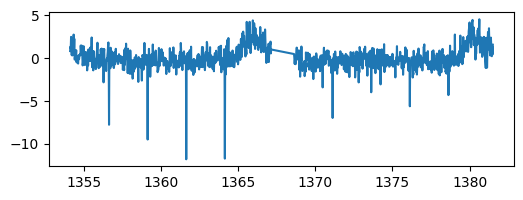

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


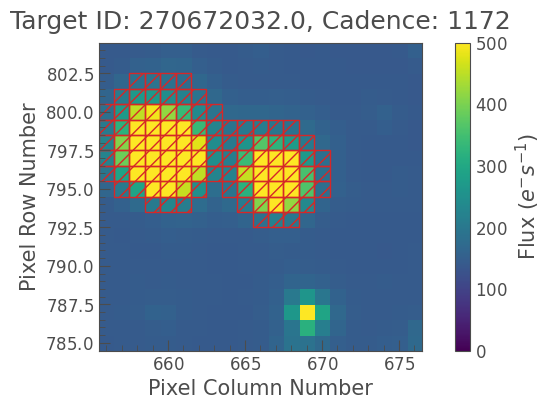

100%|██████████| 1245/1245 [00:17<00:00, 70.32it/s] 


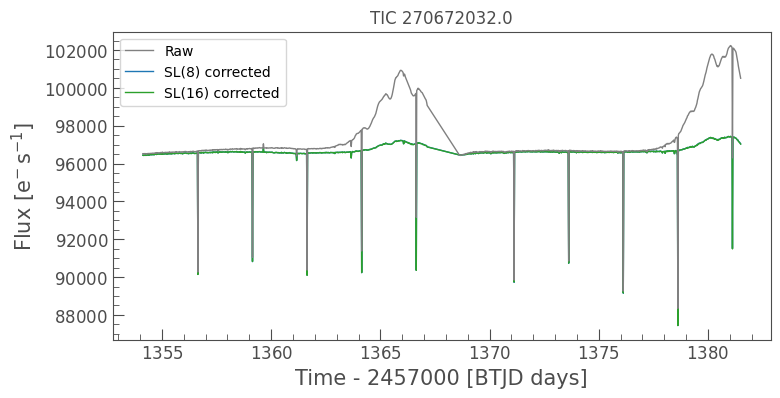

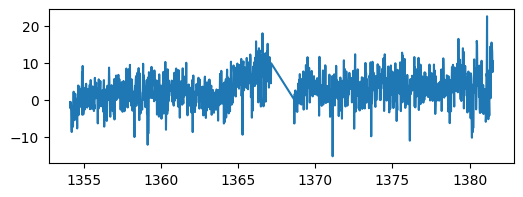

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


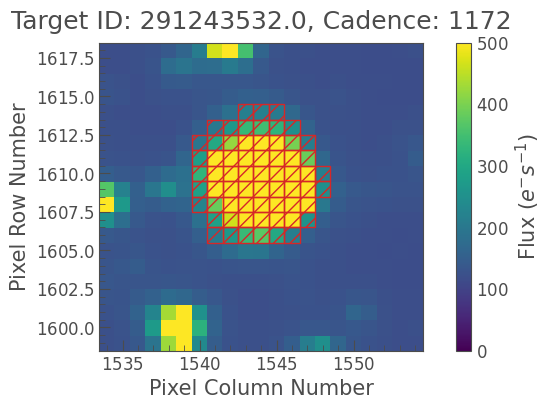

100%|██████████| 1245/1245 [00:10<00:00, 121.82it/s]


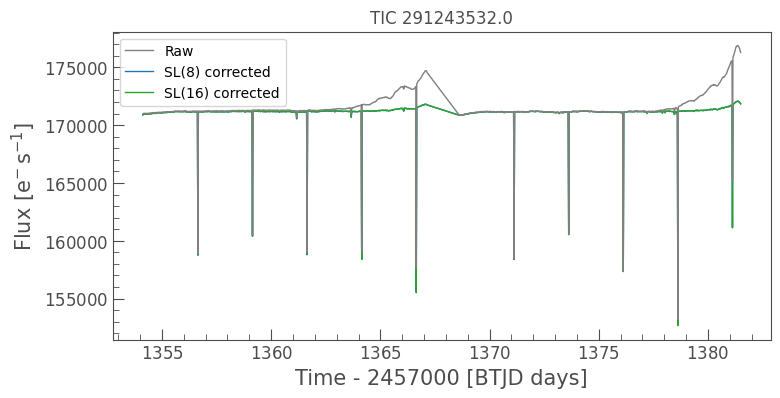

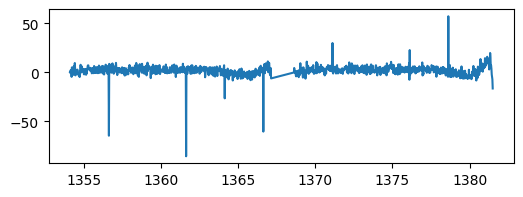

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


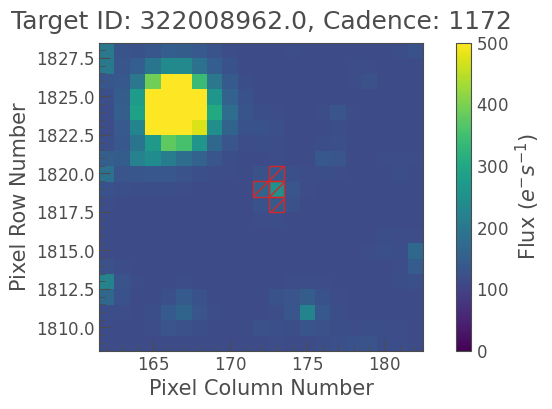

100%|██████████| 1245/1245 [00:10<00:00, 122.65it/s]


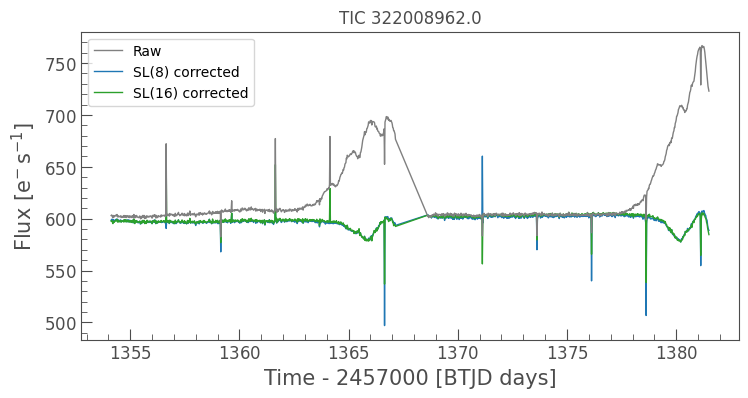

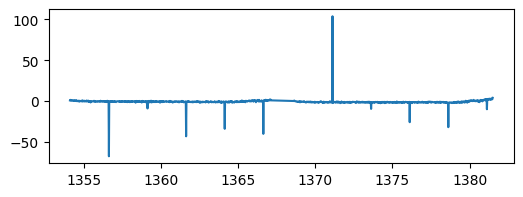

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


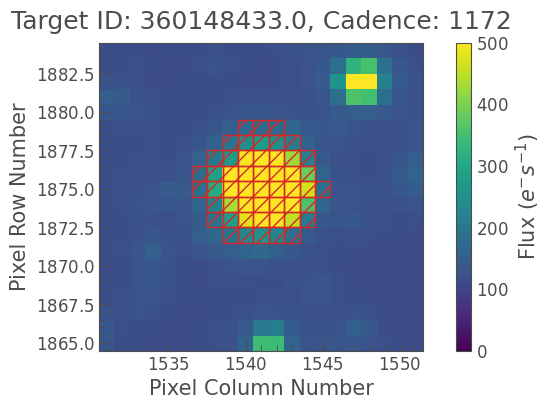

100%|██████████| 1245/1245 [00:10<00:00, 122.16it/s]


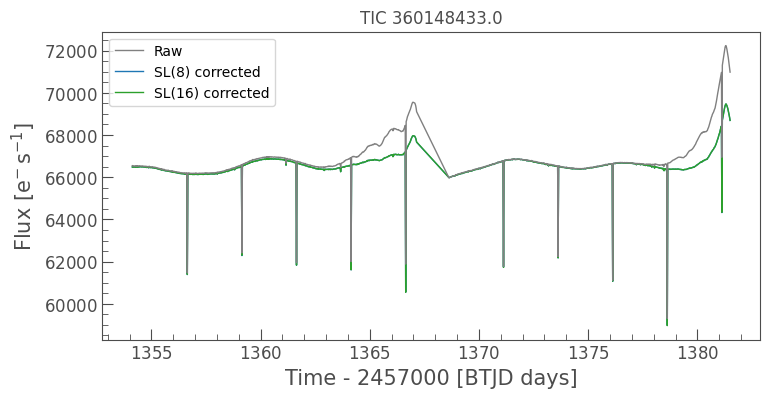

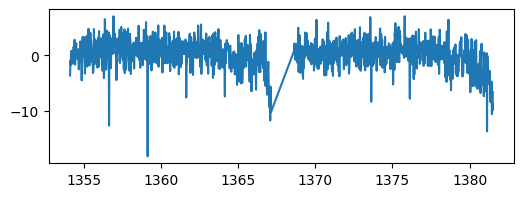

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


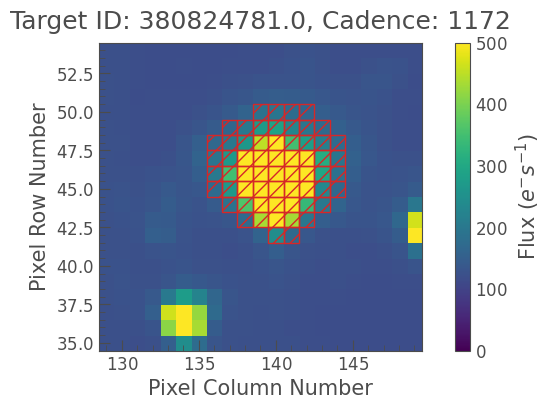

100%|██████████| 1245/1245 [00:10<00:00, 121.75it/s]


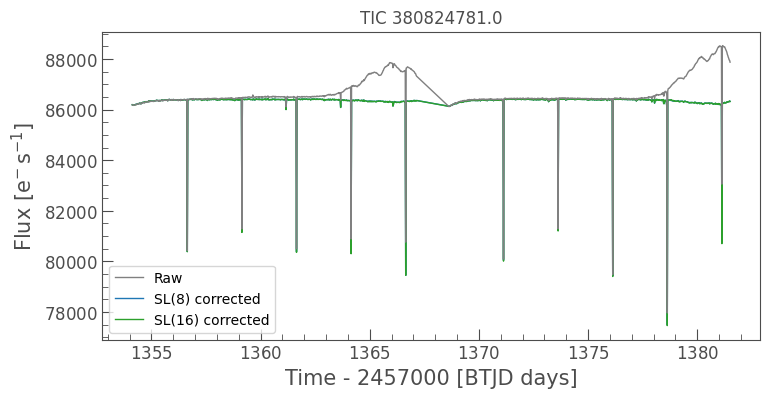

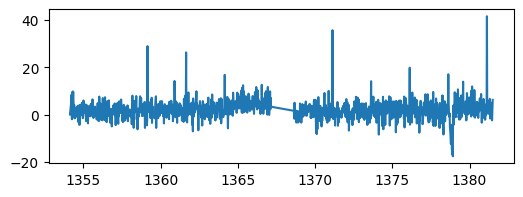

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


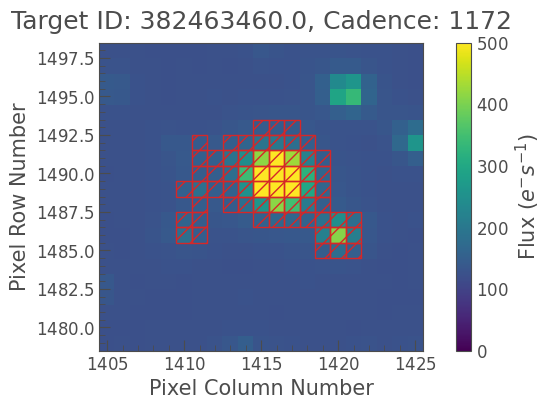

100%|██████████| 1245/1245 [00:10<00:00, 121.20it/s]


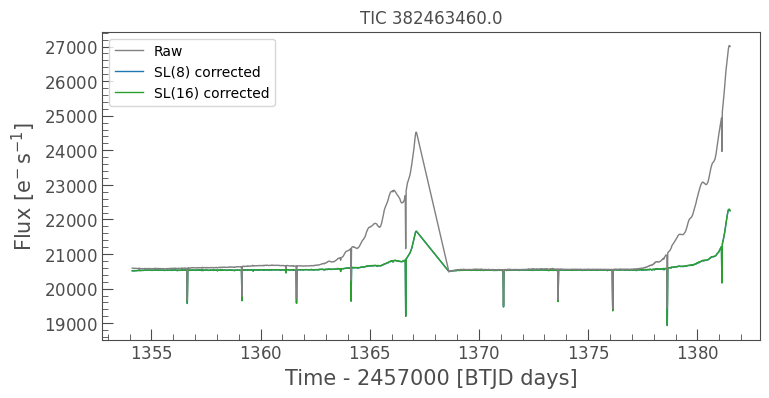

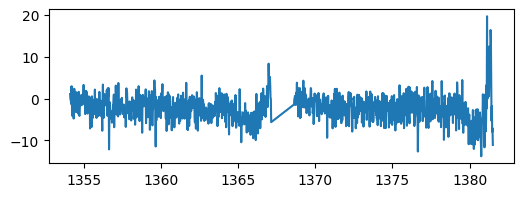

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


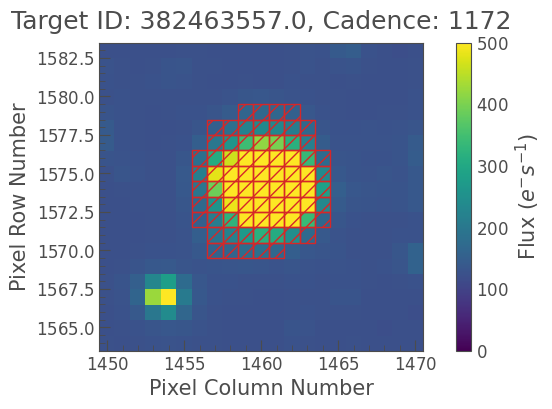

100%|██████████| 1245/1245 [00:10<00:00, 121.62it/s]


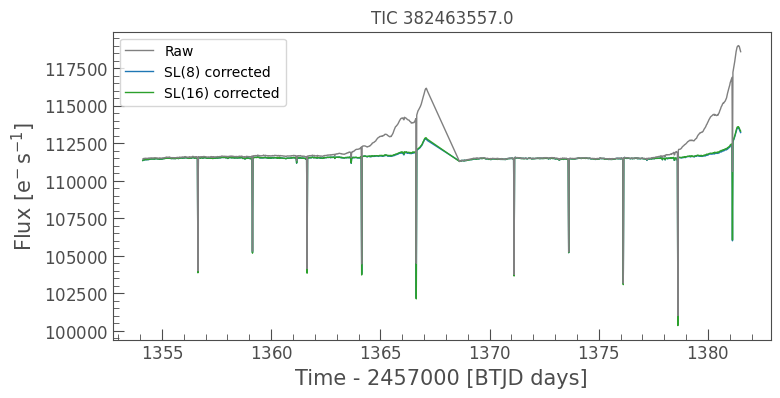

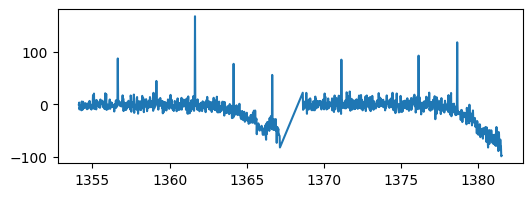

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


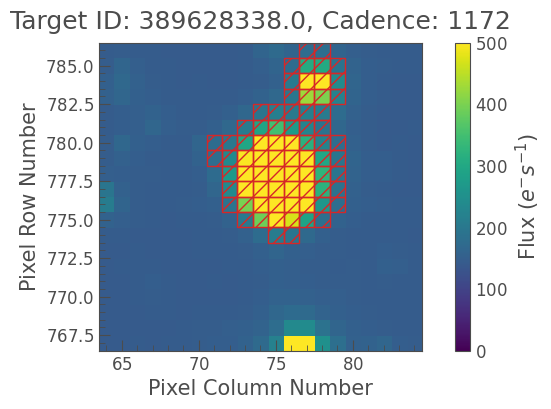

100%|██████████| 1245/1245 [00:10<00:00, 120.08it/s]


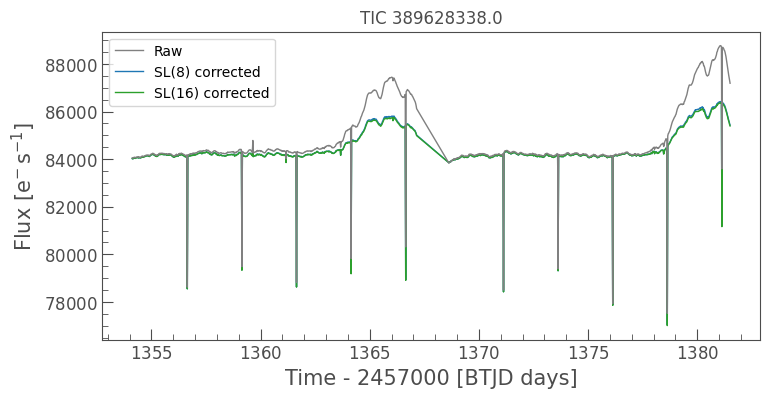

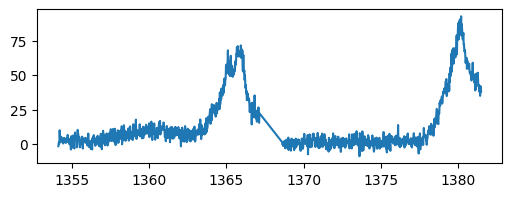

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


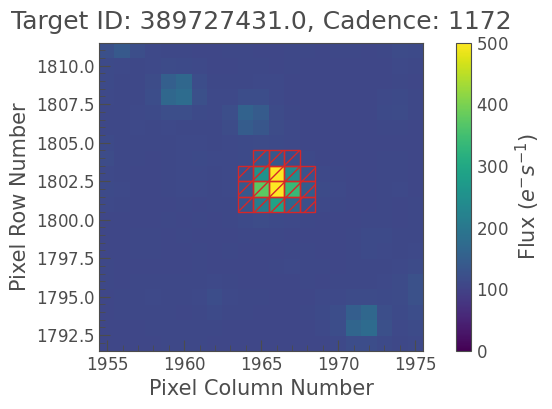

100%|██████████| 1245/1245 [00:10<00:00, 121.53it/s]


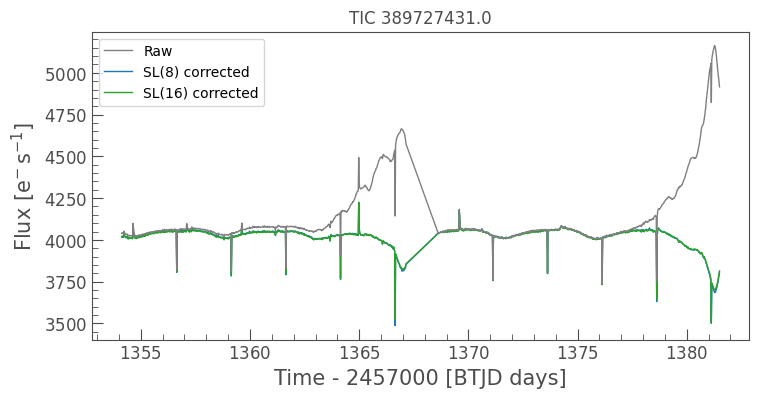

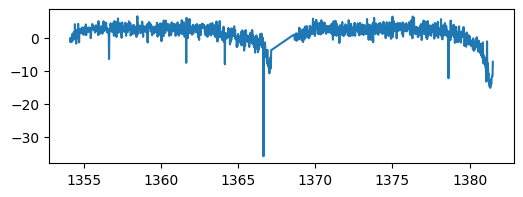

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


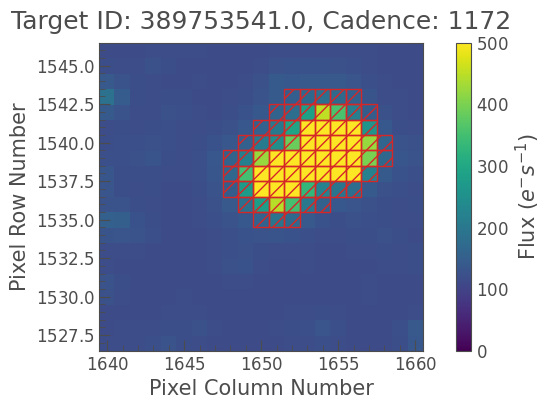

100%|██████████| 1245/1245 [00:10<00:00, 121.70it/s]


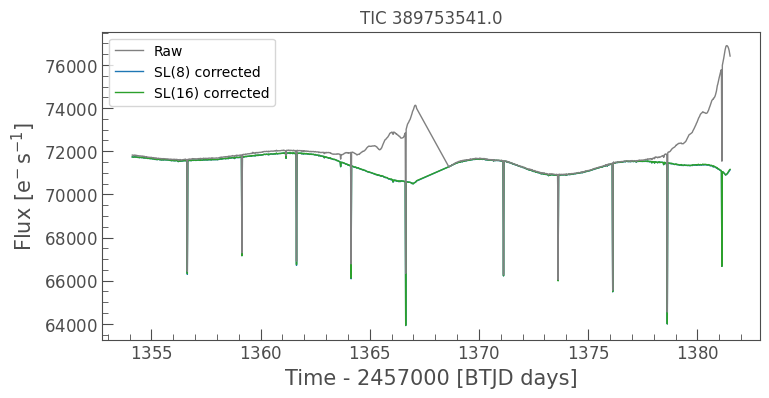

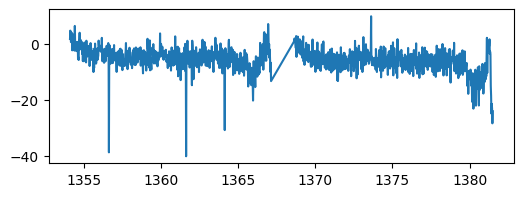

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


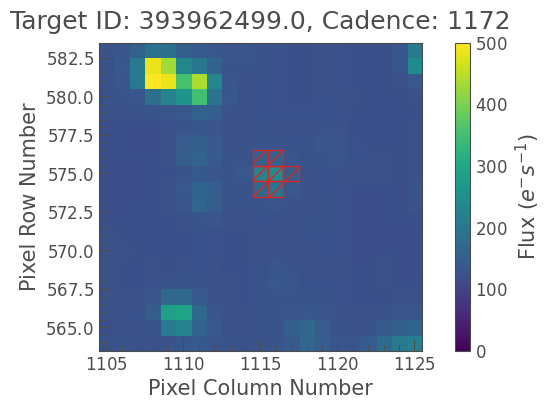

100%|██████████| 1245/1245 [00:10<00:00, 122.28it/s]


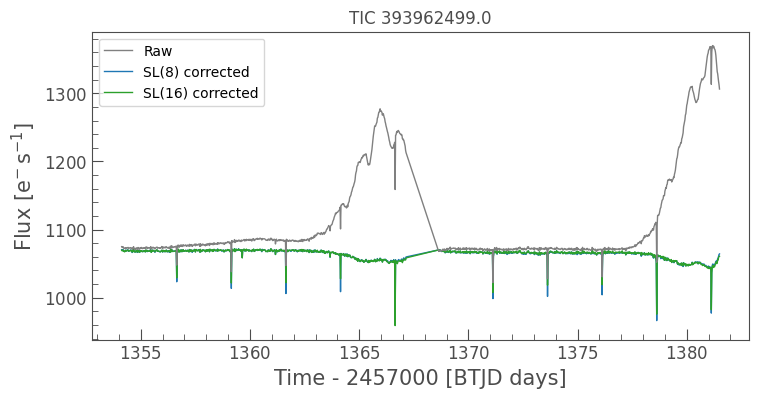

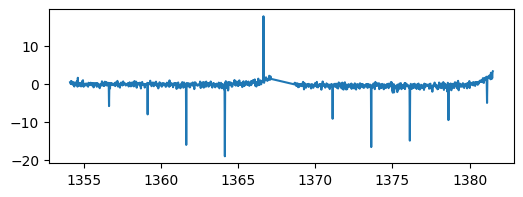

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


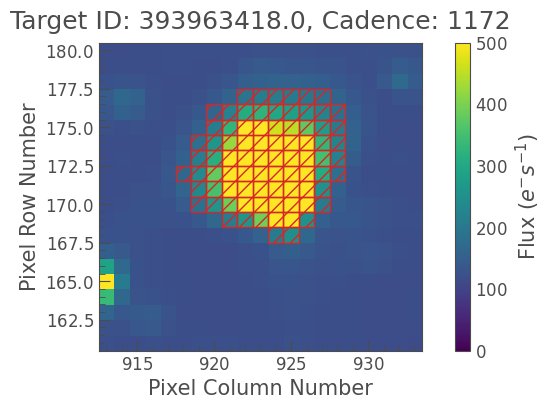

100%|██████████| 1245/1245 [00:10<00:00, 116.76it/s]


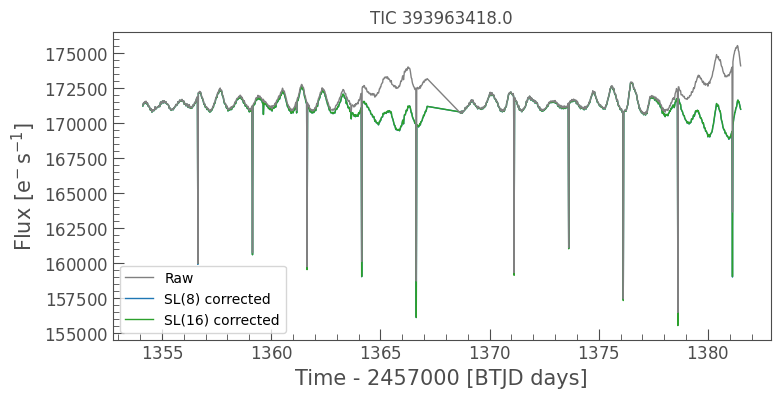

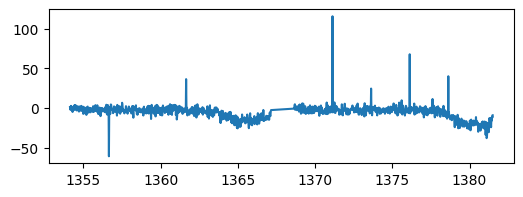

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


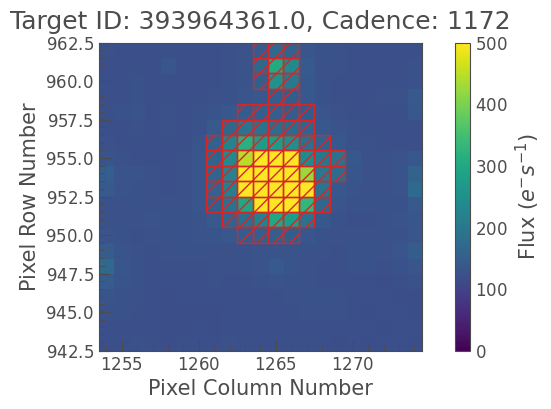

100%|██████████| 1245/1245 [00:10<00:00, 122.62it/s]


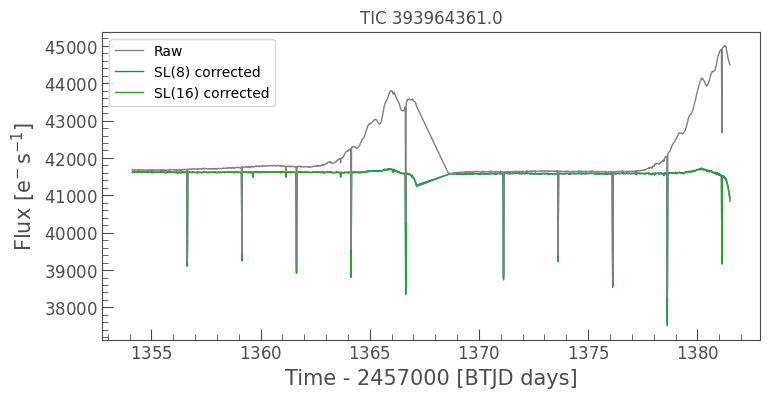

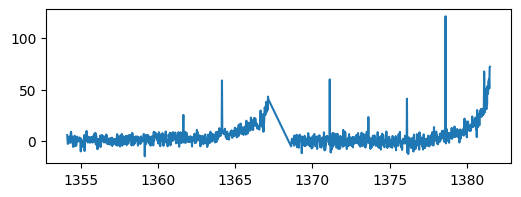

0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


INFO:lightkurve.utils:0% (0/1245) of the cadences will be ignored due to the quality mask (quality_bitmask=0).


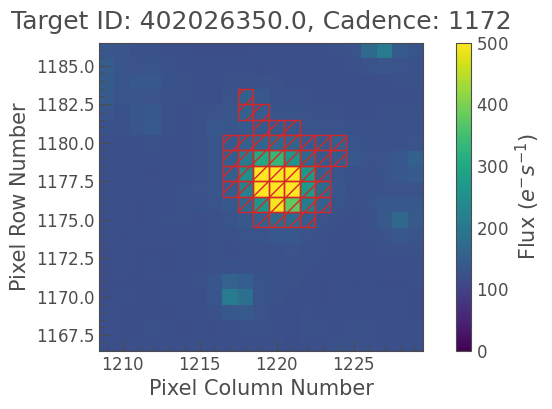

100%|██████████| 1245/1245 [00:10<00:00, 122.60it/s]


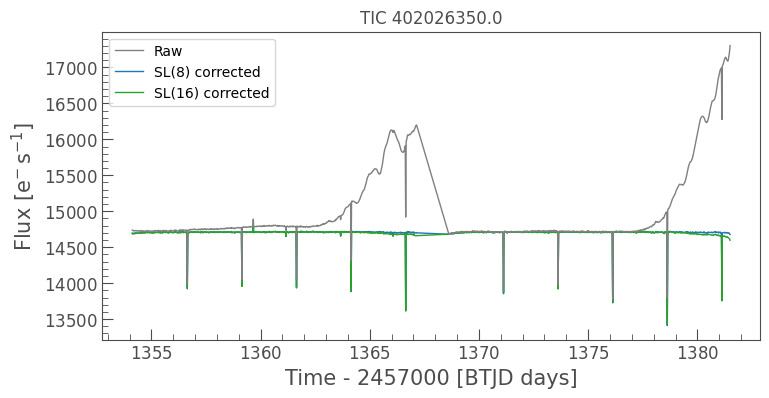

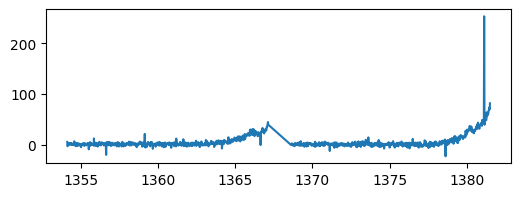

In [45]:
for k, item in tics_plot.iterrows():
    
    # coord = SkyCoord(ra=item.ra*u.deg, dec=item.dec*u.deg)
    fname = f"./data/tic_{int(item.TIC)}.0_sector{sector}_{camera}-{ccd}.fits"
    if not os.path.isfile(fname):
        fname = fname.replace(".0", "")
    
    # tcube.get_tpf(coord).writeto(fname, overwrite=True)
    tpf = lk.read(fname, quality_bitmask="none")
    tpf.targetid = item.TIC
    
    apmask = tpf.create_threshold_mask(threshold=5)
    tpf.plot(frame=1172, aperture_mask=apmask, mask_color="tab:red", vmin=0, vmax=500);
    plt.show()
    
    scatlight8 = []
    scatlight16 = []
    
    step = binsize
    row8 = np.arange(rmin, rmax, 8)
    row16 = np.arange(rmin, rmax, 16)
    col8 = np.arange(cmin, cmax, 8)
    col16 = np.arange(cmin, cmax, 16)
    eval_row = np.arange(tpf.row, tpf.row + tpf.shape[1])
    eval_col = np.arange(tpf.column, tpf.column + tpf.shape[2])
    
    for tdx in tqdm(range(cube_sl.shape[0])):
        interp2d = RectBivariateSpline(col8, row8, cube_sl_lin[tdx] if fillnan else cube_sl[tdx])
        scatlight8.append(interp2d(eval_col, eval_row).T)

        binned = cube_sl_lin[tdx] if fillnan else cube_sl[tdx]
        binned = pooling_2d(
                        binned,
                        kernel_size=2,
                        stride=2,
                        stat=np.nanmedian,
                    )
        interp2d = RectBivariateSpline(col16, row16, binned)
        scatlight16.append(interp2d(eval_col, eval_row).T)
        
    scatlight8 = np.array(scatlight8)
    scatlight16 = np.array(scatlight16)
    flux_corr8 = tpf.flux - scatlight8 * tpf.flux.unit
    flux_corr16 = tpf.flux - scatlight16 * tpf.flux.unit
    
    lc = tpf.extract_aperture_photometry(aperture_mask=apmask)
    lc_corr8 = np.nansum(flux_corr8[:, apmask], axis=1)
    lc_corr16 = np.nansum(flux_corr16[:, apmask], axis=1)
    
    ax = lc.plot(label="Raw", lw=1, c="gray")
    ax.plot(lc.time.value, lc_corr8, label="SL(8) corrected", zorder=-5000, lw=1, c="tab:blue")
    ax.plot(lc.time.value, lc_corr16, label="SL(16) corrected", zorder=-5000, lw=1, c="tab:green")
    ax.set_title(f"TIC {item.TIC}")
    plt.legend()
    plt.show()

    plt.figure(figsize=(6,2))
    plt.plot(lc.time.value, lc_corr8 - lc_corr16)
    plt.show()

    # break